In [1]:
import dense_correspondence_manipulation.utils.utils as utils
utils.add_dense_correspondence_to_python_path()
from dense_correspondence.training.training import *
import sys
import logging
import json
import time

#utils.set_default_cuda_visible_devices()
utils.set_cuda_visible_devices([0]) # use this to manually set CUDA_VISIBLE_DEVICES

from dense_correspondence.training.training import DenseCorrespondenceTraining
from dense_correspondence.dataset.spartan_dataset_masked import SpartanDataset
logging.basicConfig(level=logging.INFO)

import dense_correspondence.evaluation.evaluation
reload(dense_correspondence.evaluation.evaluation)
from dense_correspondence.evaluation.evaluation import DenseCorrespondenceEvaluation

cuda = torch.cuda.is_available()
DEVICE = "cuda" if cuda else "cpu"
if cuda:
    print("CUDA GPU!")
else:
    print("CPU!")

setting CUDA_VISIBLE_DEVICES =  0,
CUDA GPU!


## Load the configuration for training

In [2]:
config_filename = os.path.join(utils.getDenseCorrespondenceSourceDir(), 'config', 'dense_correspondence', 
                               'dataset', 'composite', 'op_pretraining.yaml')
data_config = utils.getDictFromYamlFilename(config_filename)
data_config['logs_root_path'] = '/home/ashek/code/data/pdc/logs_proto'

train_config_file = os.path.join(utils.getDenseCorrespondenceSourceDir(), 'config', 'dense_correspondence', 
                               'training', 'training.yaml')

train_config = utils.getDictFromYamlFilename(train_config_file)
train_config['device'] = DEVICE
train_config['dense_correspondence_network']['device'] = DEVICE

logging_dir = "/home/ashek/code/data/pdc/trained_models/tutorials"
num_iterations = 3500
d = 3 # the descriptor dimension
datetime_str = time.strftime('%Y_%m_%d_%H:%M:%S', time.localtime())
name = "dcn_pretraining_" + datetime_str
train_config["training"]["logging_dir_name"] = name
train_config["training"]["logging_dir"] = logging_dir
train_config["dense_correspondence_network"]["descriptor_dimension"] = d
train_config["training"]["num_iterations"] = num_iterations
print(json.dumps(train_config, indent=2))

{
  "device": "cuda", 
  "training": {
    "data_type_probabilities": {
      "SINGLE_OBJECT_ACROSS_SCENE": 0, 
      "SINGLE_OBJECT_WITHIN_SCENE": 1, 
      "DIFFERENT_OBJECT": 0, 
      "SYNTHETIC_MULTI_OBJECT": 0, 
      "MULTI_OBJECT": 0
    }, 
    "num_test_imgs_per_scene": 1, 
    "save_rate": 1000, 
    "num_workers": 5, 
    "logging_dir": "/home/ashek/code/data/pdc/trained_models/tutorials", 
    "compute_test_loss": true, 
    "sample_matches_only_off_mask": true, 
    "fraction_masked_non_matches": 0.5, 
    "batch_size": 1, 
    "domain_randomize": true, 
    "num_matching_attempts": 10000, 
    "weight_decay": 0.0001, 
    "learning_rate_decay": 0.9, 
    "compute_test_loss_rate": 500, 
    "num_non_matches_per_match": 150, 
    "num_iterations": 3500, 
    "steps_between_learning_rate_decay": 250, 
    "cross_scene_num_samples": 10000, 
    "logging_dir_name": "dcn_pretraining_2022_05_13_16:34:47", 
    "loss_function": "pixelwise_contrastive_loss", 
    "fraction_backgr

## Train the network

This should take about ~12-15 minutes with a GTX 1080 Ti

In [3]:
# dataset.get_pose_data(dataset.get_scene_list()[0])
data_config

{'logs_root_path': '/home/ashek/code/data/pdc/logs_proto',
 'multi_object_scenes_config_files': [],
 'single_object_scenes_config_files': ['10_drill_scenes.yaml',
  'caterpillar_upright.yaml',
  'dramamine.yaml',
  'gopro_box.yaml',
  'headphones.yaml']}

training descriptor of dimension 3
Using SpartanDataset:
   - in train mode
   - number of scenes 40
   - total images:     12869
DATASET MODE: train
Using SpartanDataset:
   - in test mode
   - number of scenes 11
   - total images:     3904
DATASET MODE: test
using SINGLE_OBJECT_WITHIN_SCENE
using SINGLE_OBJECT_WITHIN_SCENE
using SINGLE_OBJECT_WITHIN_SCENE
using SINGLE_OBJECT_WITHIN_SCENE
('dir_name: ', 'dcn_pretraining_2022_05_13_16:34:47')
('logging_dir:', '/home/ashek/code/data/pdc/trained_models/tutorials/dcn_pretraining_2022_05_13_16:34:47')
cuda


  0%|          | 1/3500 [00:00<36:06,  1.62it/s]/home/ashek/.local/lib/python2.7/site-packages/torch/nn/functional.py:2589: UserWarning: nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.")




-----------Test Data Evaluation on caterpillar----------------
Image pair (150, 1060)
Could not find descriptor image stats...
Only normalizing pairs of images!


/home/ashek/code/dense_correspondence/network/dense_correspondence_network.py:285: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img_tensor = torch.tensor(img_tensor, device=self.device)


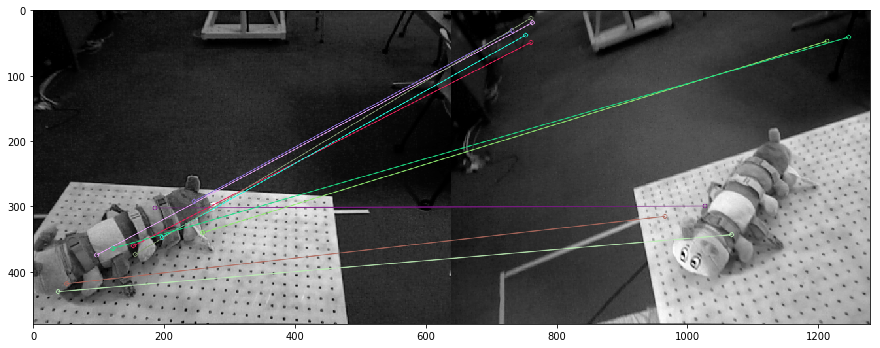

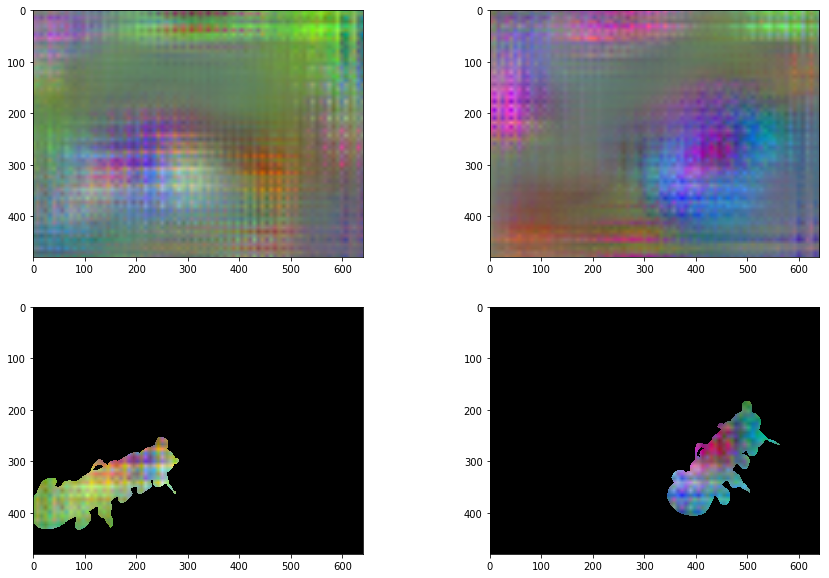



-----------Test Data Evaluation on dramamine----------------
Image pair (2055, 2260)
Could not find descriptor image stats...
Only normalizing pairs of images!


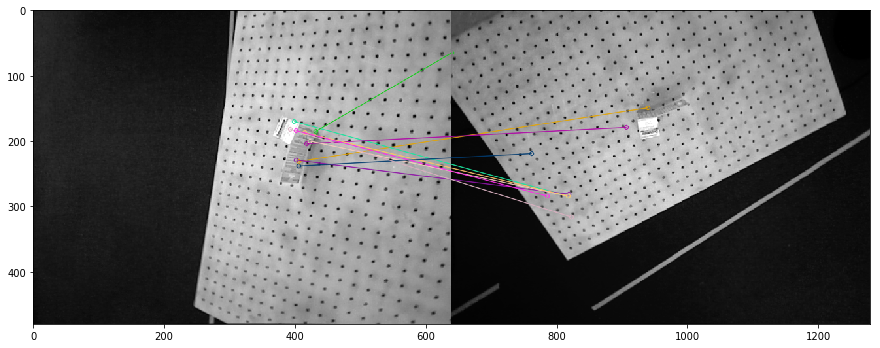

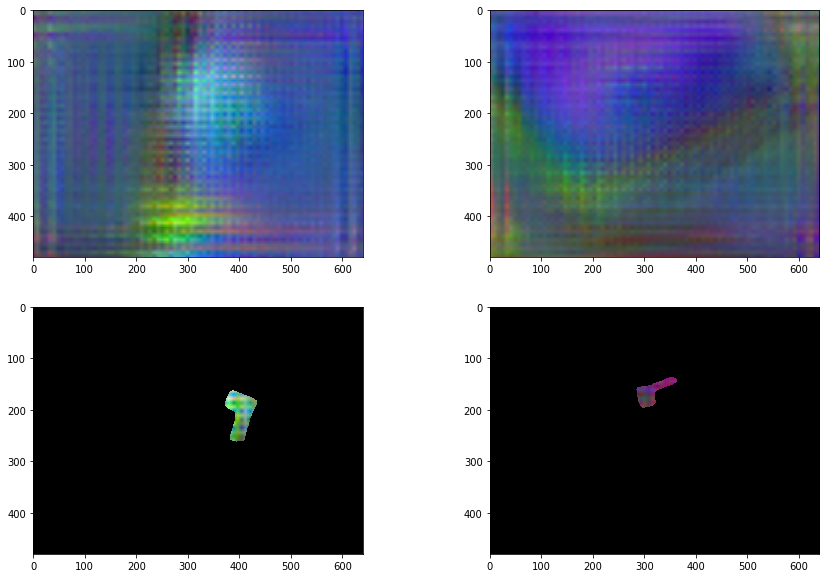



-----------Test Data Evaluation on drill----------------
Image pair (851, 1592)
Could not find descriptor image stats...
Only normalizing pairs of images!


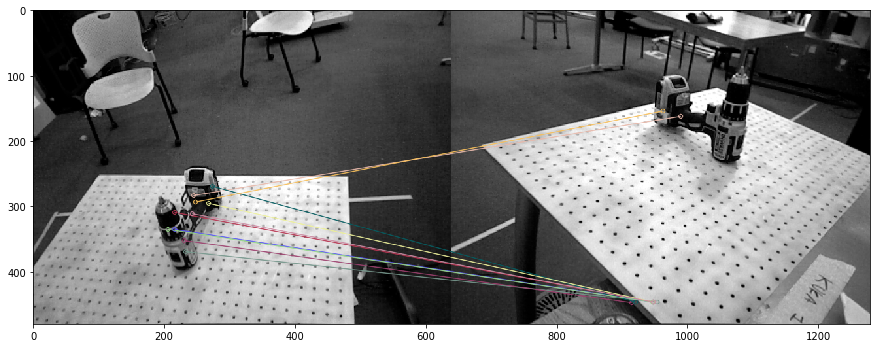

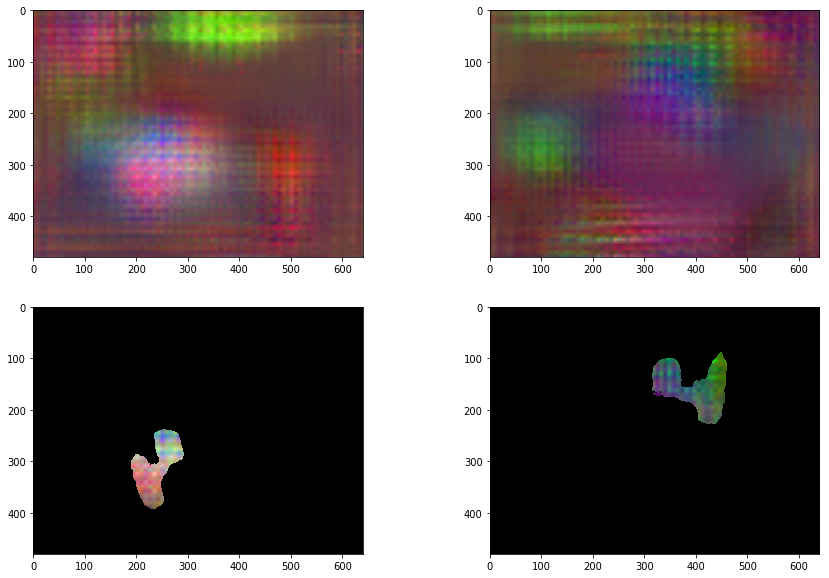



-----------Test Data Evaluation on gopro_box----------------
Image pair (11, 1079)
Could not find descriptor image stats...
Only normalizing pairs of images!


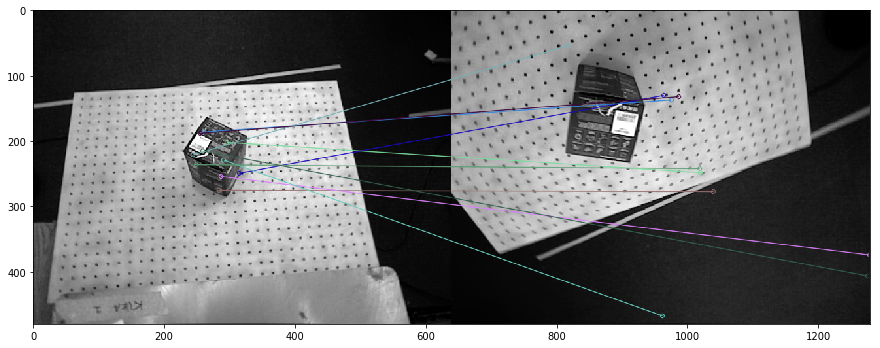

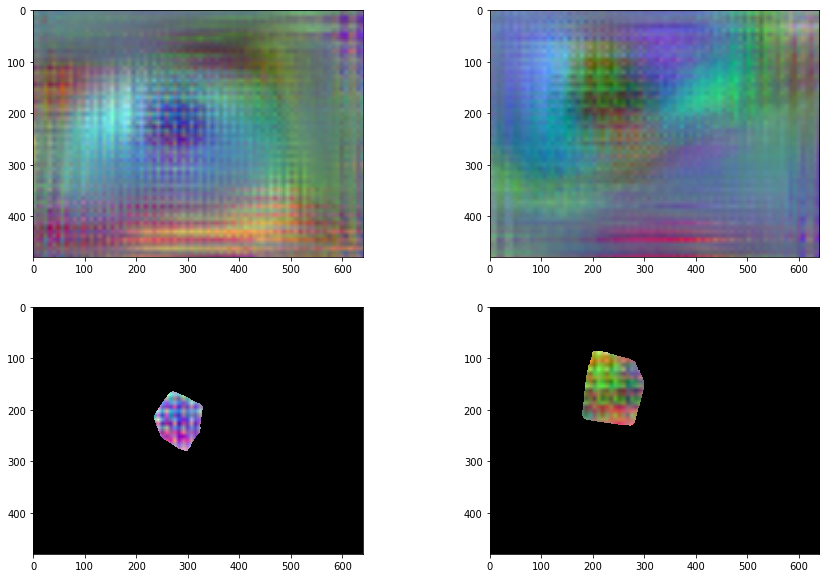



-----------Test Data Evaluation on headphones----------------
Image pair (3055, 2190)
Could not find descriptor image stats...
Only normalizing pairs of images!


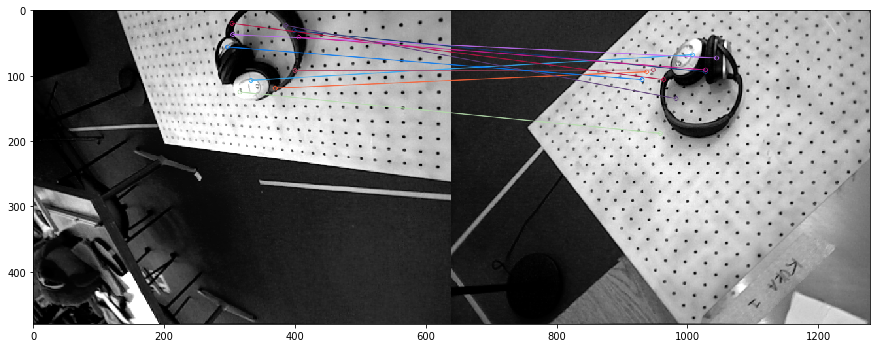

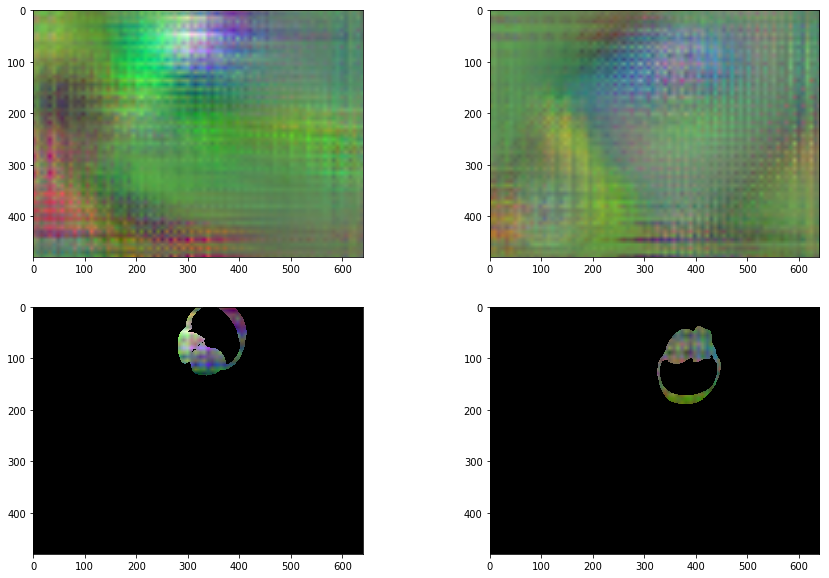

  2%|▏         | 79/3500 [00:43<23:40,  2.41it/s] 


 empty data, continuing 



  2%|▏         | 86/3500 [00:46<22:15,  2.56it/s]


 empty data, continuing 



  4%|▍         | 156/3500 [01:15<23:28,  2.37it/s]


 empty data, continuing 



  9%|▉         | 326/3500 [02:28<23:32,  2.25it/s]


 empty data, continuing 



 12%|█▏        | 413/3500 [03:05<22:08,  2.32it/s]

warning, empty mask b


 13%|█▎        | 444/3500 [03:19<22:34,  2.26it/s]


 empty data, continuing 



 14%|█▍        | 486/3500 [03:37<21:41,  2.32it/s]


 empty data, continuing 



 14%|█▍        | 500/3500 [03:42<22:01,  2.27it/s]



-----------Test Data Evaluation on caterpillar----------------
Image pair (681, 2743)
Could not find descriptor image stats...
Only normalizing pairs of images!


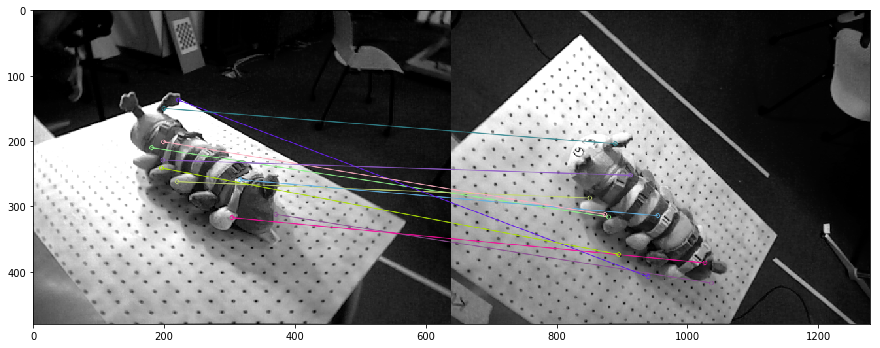

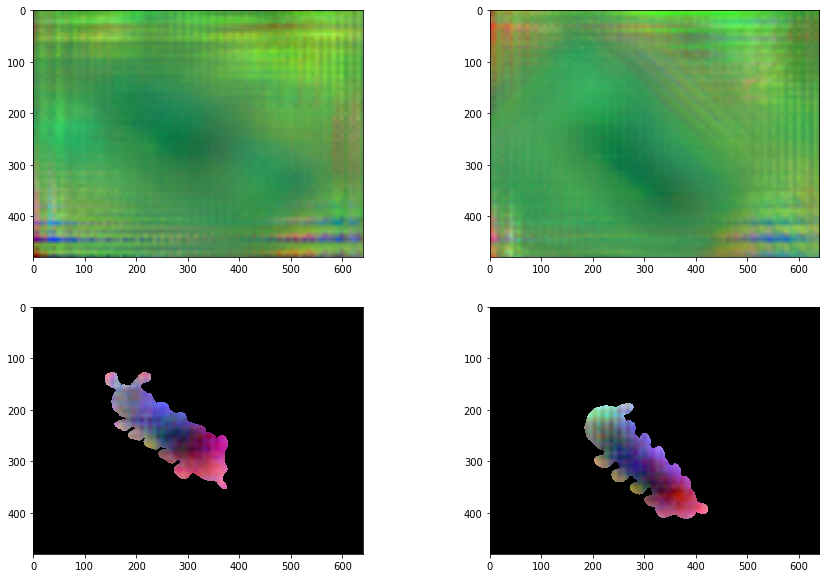



-----------Test Data Evaluation on dramamine----------------
Image pair (1892, 278)
Could not find descriptor image stats...
Only normalizing pairs of images!


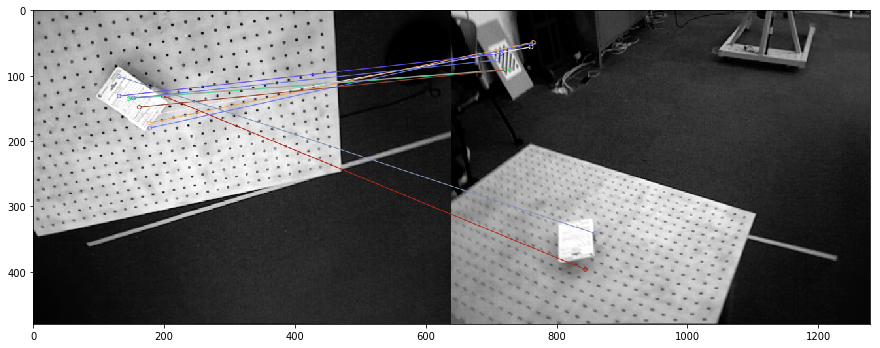

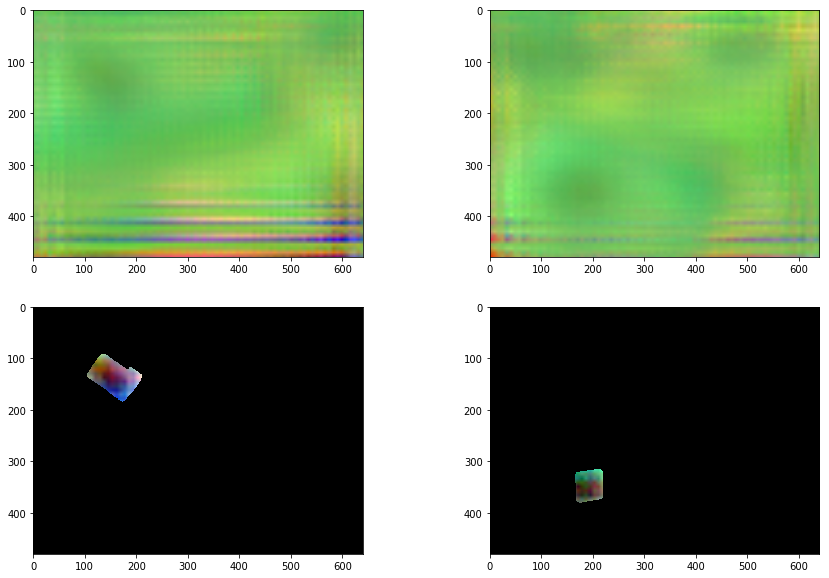



-----------Test Data Evaluation on drill----------------
Image pair (241, 651)
Could not find descriptor image stats...
Only normalizing pairs of images!


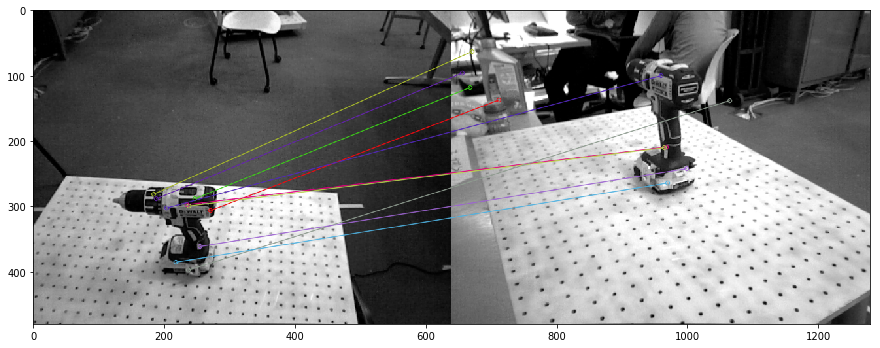

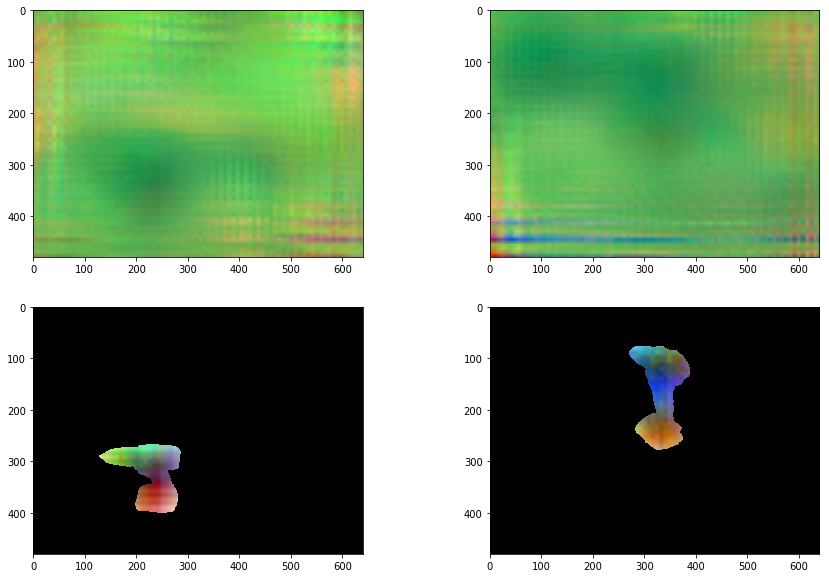



-----------Test Data Evaluation on gopro_box----------------
Image pair (1061, 44)
Could not find descriptor image stats...
Only normalizing pairs of images!


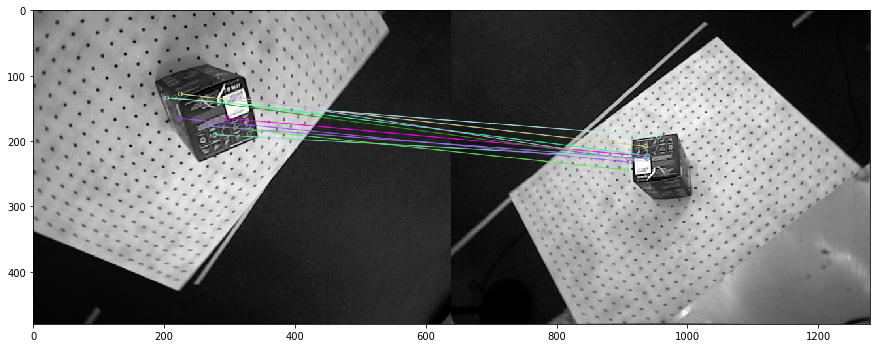

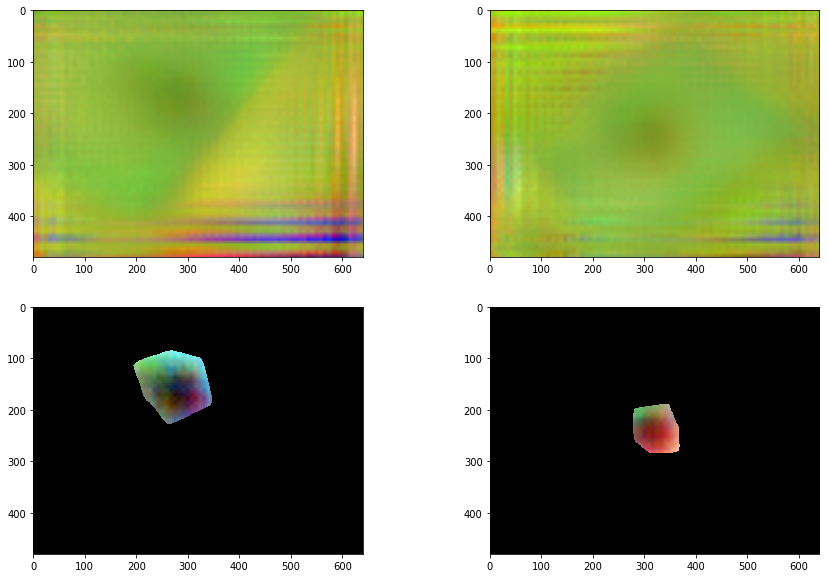



-----------Test Data Evaluation on headphones----------------
Image pair (751, 1656)
Could not find descriptor image stats...
Only normalizing pairs of images!


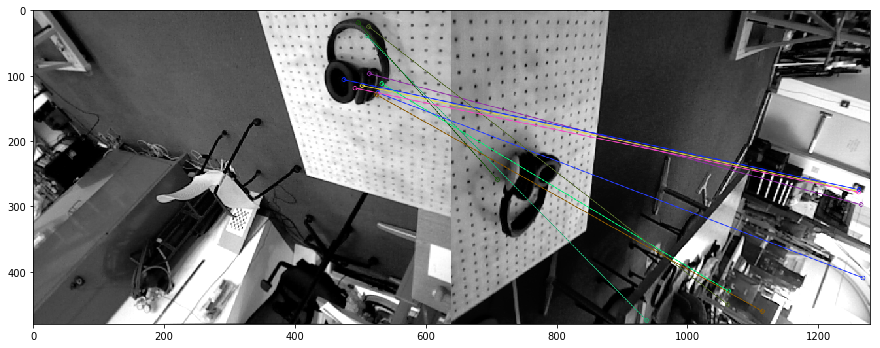

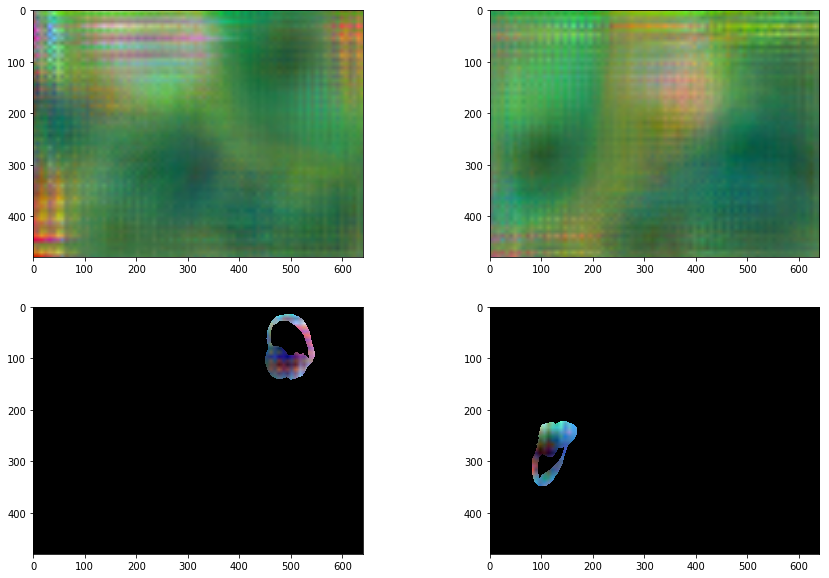

 19%|█▉        | 657/3500 [05:01<20:36,  2.30it/s]  


 empty data, continuing 



 22%|██▏       | 778/3500 [05:53<17:56,  2.53it/s]/home/ashek/code/modules/dense_correspondence_manipulation/utils/utils.py:266: RuntimeWarning: invalid value encountered in arccos
  theta = 2*np.arccos(2 * np.dot(q,r)**2 - 1)
 23%|██▎       | 798/3500 [06:02<20:01,  2.25it/s]


 empty data, continuing 



 29%|██▊       | 1000/3500 [07:30<18:19,  2.27it/s]



-----------Test Data Evaluation on caterpillar----------------
Image pair (739, 1382)
Could not find descriptor image stats...
Only normalizing pairs of images!


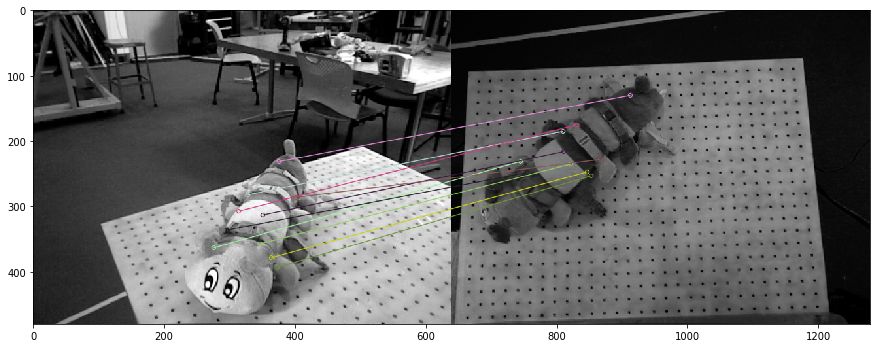

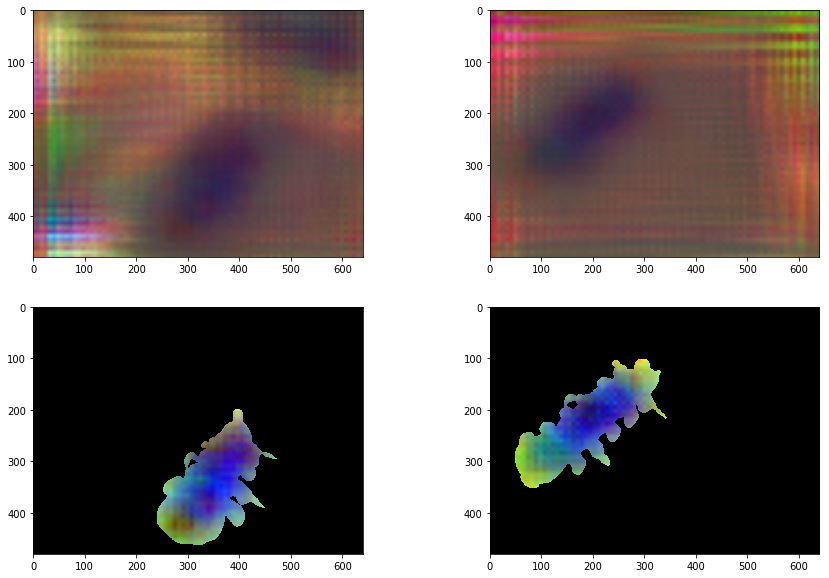



-----------Test Data Evaluation on dramamine----------------
Image pair (1916, 9)
Could not find descriptor image stats...
Only normalizing pairs of images!


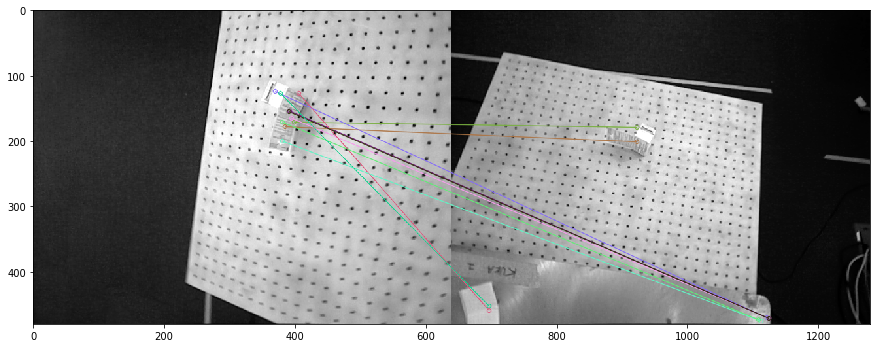

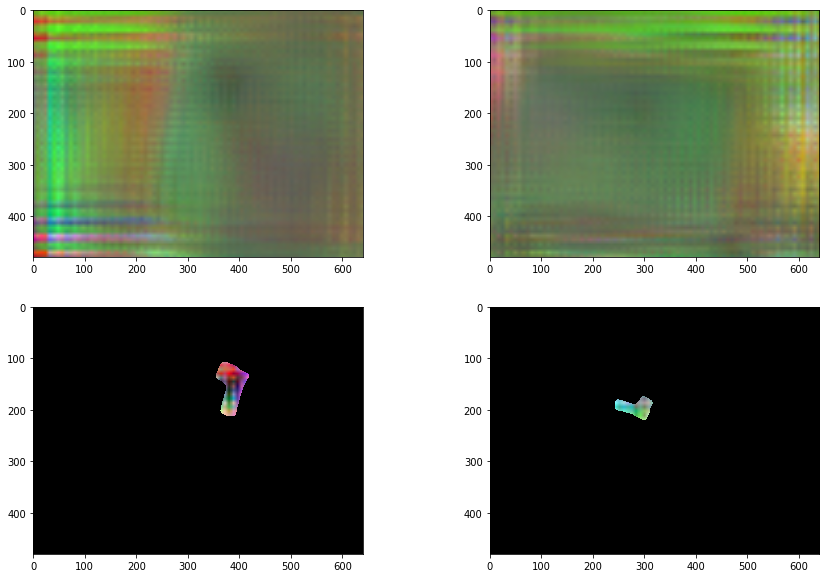



-----------Test Data Evaluation on drill----------------
Image pair (98, 2452)
Could not find descriptor image stats...
Only normalizing pairs of images!


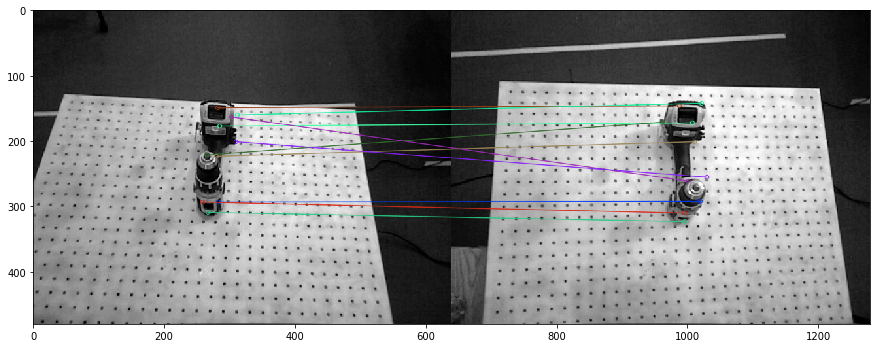

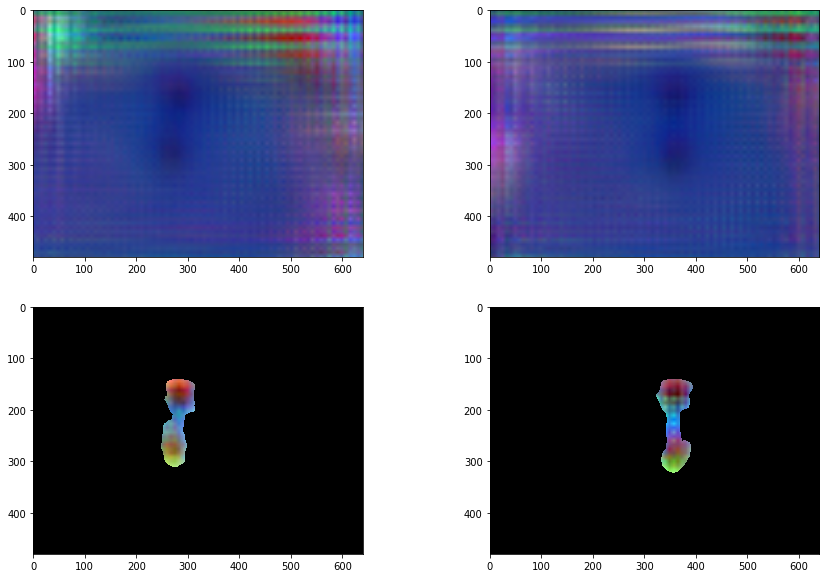



-----------Test Data Evaluation on gopro_box----------------
Image pair (1042, 1089)
Could not find descriptor image stats...
Only normalizing pairs of images!


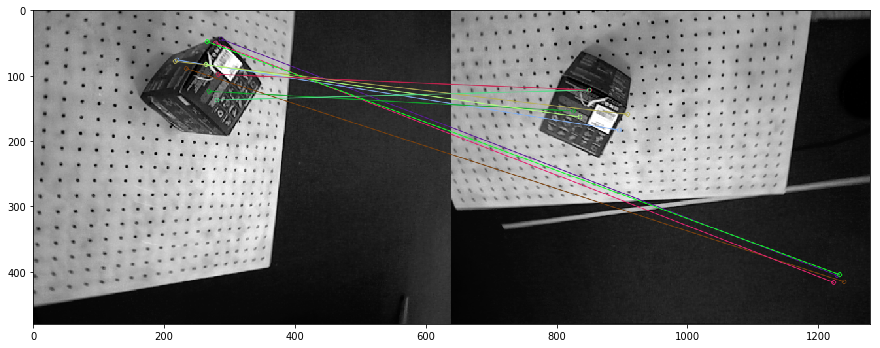

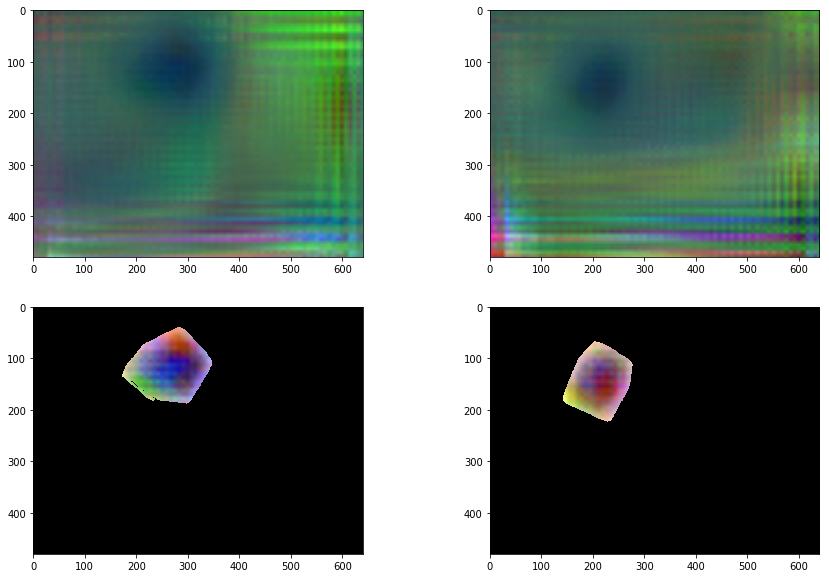



-----------Test Data Evaluation on headphones----------------
Image pair (762, 2583)
Could not find descriptor image stats...
Only normalizing pairs of images!


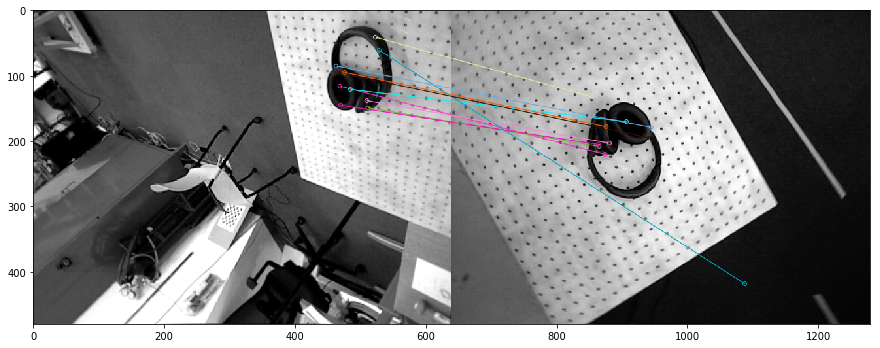

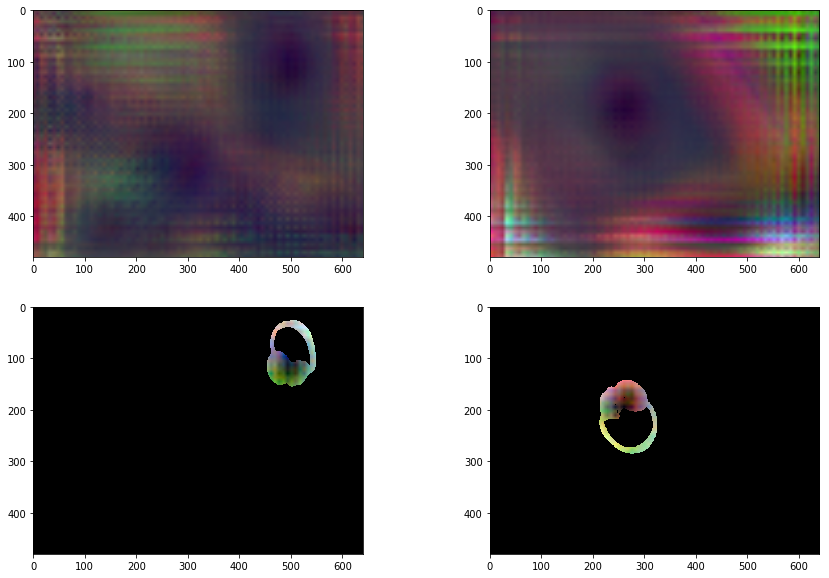

 30%|███       | 1055/3500 [08:04<19:35,  2.08it/s]  

warning, empty mask b


 31%|███       | 1088/3500 [08:19<17:37,  2.28it/s]

warning, empty mask b


 38%|███▊      | 1338/3500 [10:08<16:05,  2.24it/s]

warning, empty mask b


 41%|████▏     | 1452/3500 [10:58<14:53,  2.29it/s]/home/ashek/code/modules/dense_correspondence_manipulation/utils/utils.py:266: RuntimeWarning: invalid value encountered in arccos
  theta = 2*np.arccos(2 * np.dot(q,r)**2 - 1)
 43%|████▎     | 1500/3500 [11:19<14:35,  2.28it/s]



-----------Test Data Evaluation on caterpillar----------------
Image pair (115, 2674)
Could not find descriptor image stats...
Only normalizing pairs of images!


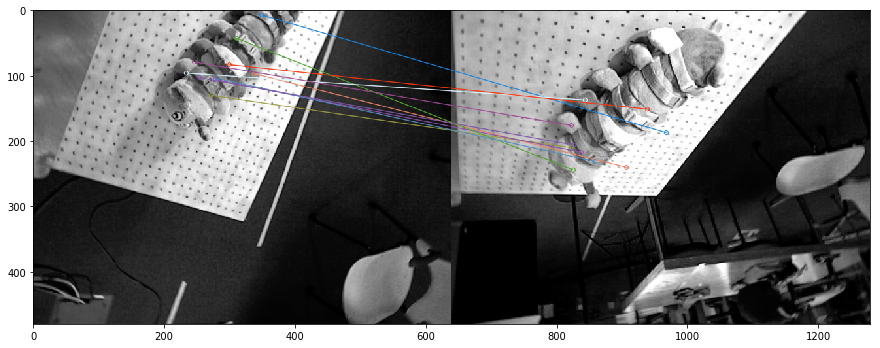

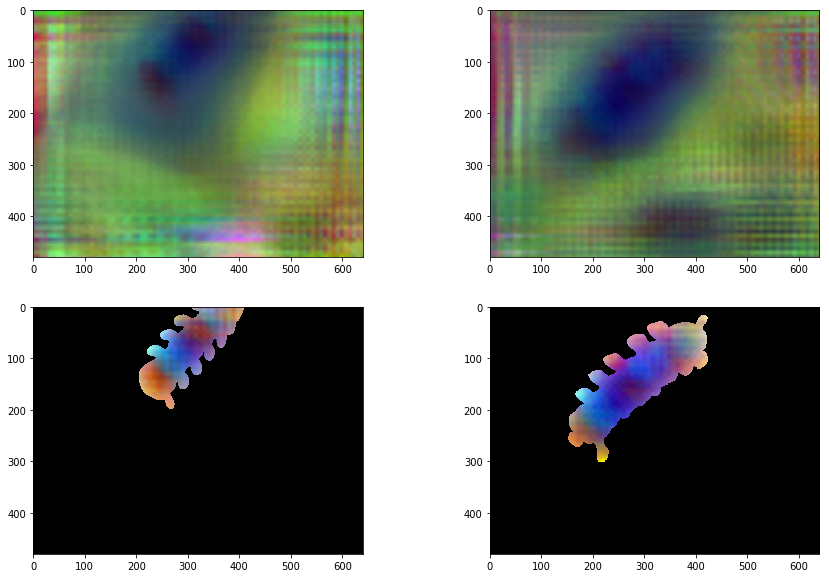



-----------Test Data Evaluation on dramamine----------------
Image pair (1161, 2097)
Could not find descriptor image stats...
Only normalizing pairs of images!


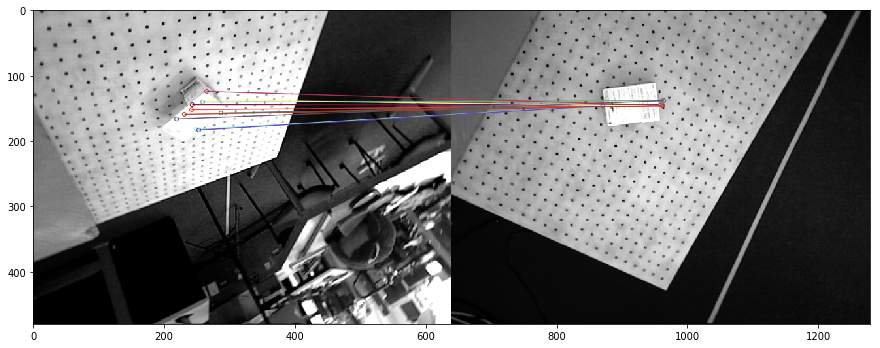

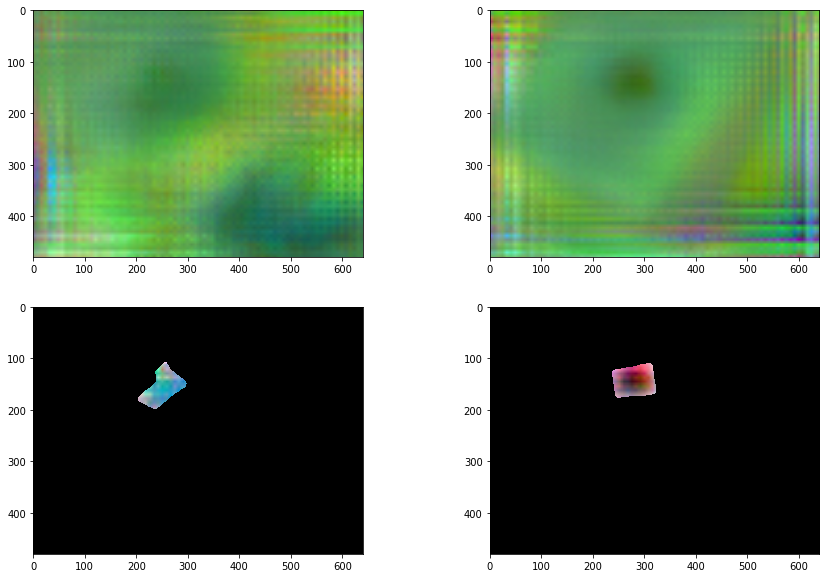



-----------Test Data Evaluation on drill----------------
Image pair (1820, 1251)
Could not find descriptor image stats...
Only normalizing pairs of images!


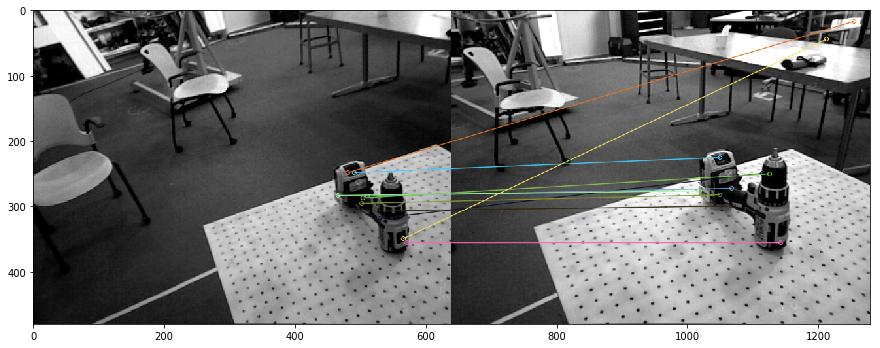

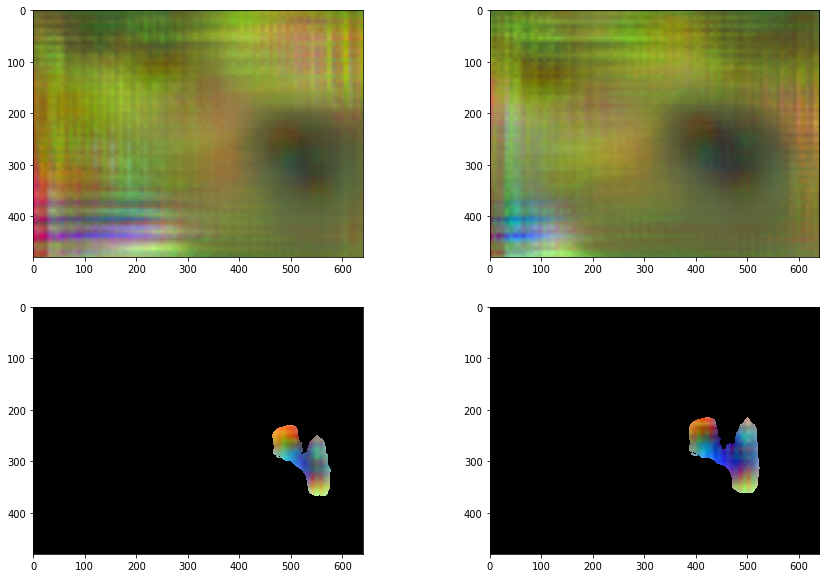



-----------Test Data Evaluation on gopro_box----------------
Image pair (891, 1441)
Could not find descriptor image stats...
Only normalizing pairs of images!


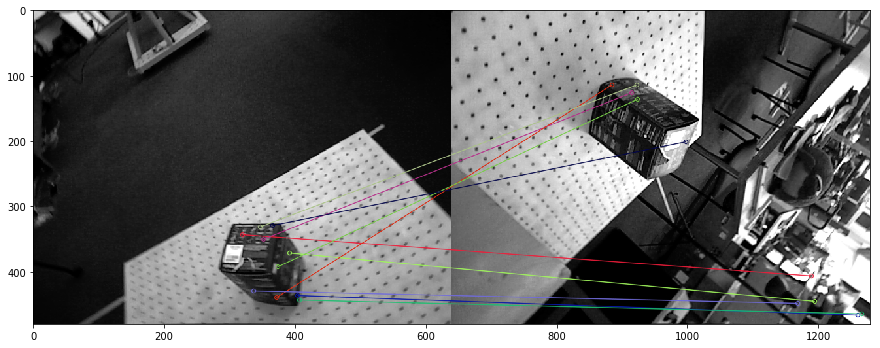

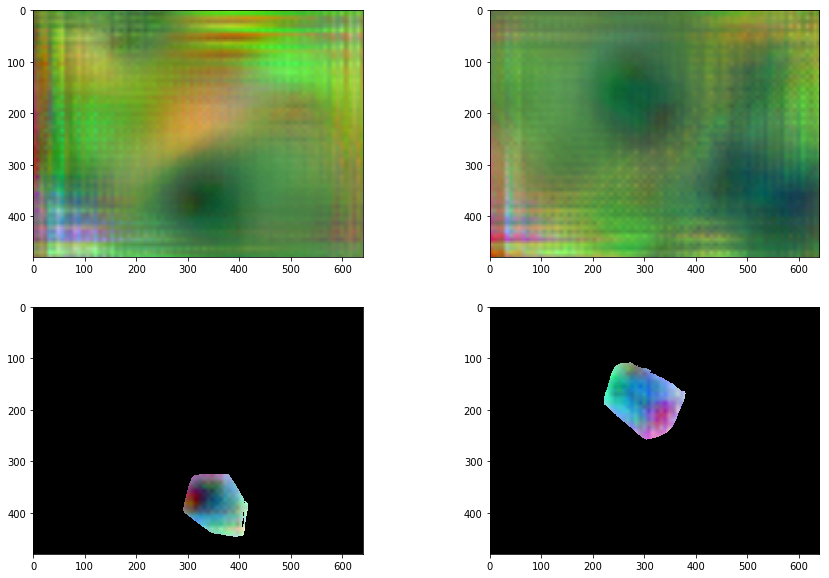



-----------Test Data Evaluation on headphones----------------
Image pair (966, 1650)
Could not find descriptor image stats...
Only normalizing pairs of images!


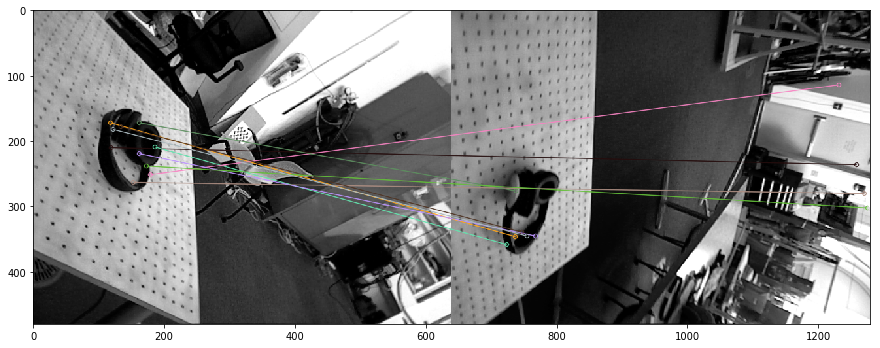

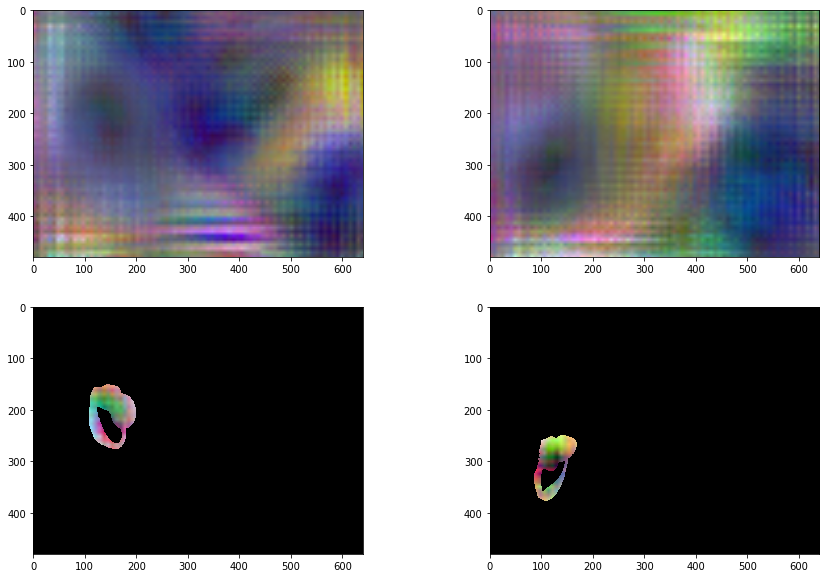

 45%|████▍     | 1570/3500 [11:59<14:03,  2.29it/s]  

warning, empty mask b


 46%|████▌     | 1595/3500 [12:10<13:54,  2.28it/s]

warning, empty mask b


 52%|█████▏    | 1832/3500 [13:54<11:42,  2.37it/s]

warning, empty mask b


 56%|█████▌    | 1943/3500 [14:42<11:08,  2.33it/s]

warning, empty mask b


 57%|█████▋    | 2000/3500 [15:07<10:53,  2.30it/s]

warning, empty mask b


-----------Test Data Evaluation on caterpillar----------------
Image pair (3294, 2294)
Could not find descriptor image stats...
Only normalizing pairs of images!


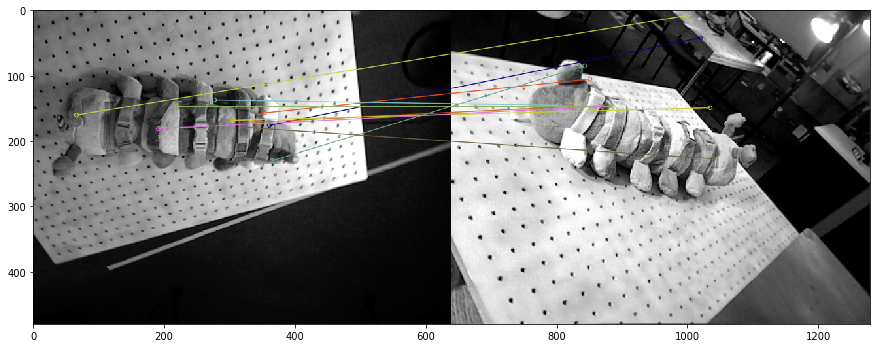

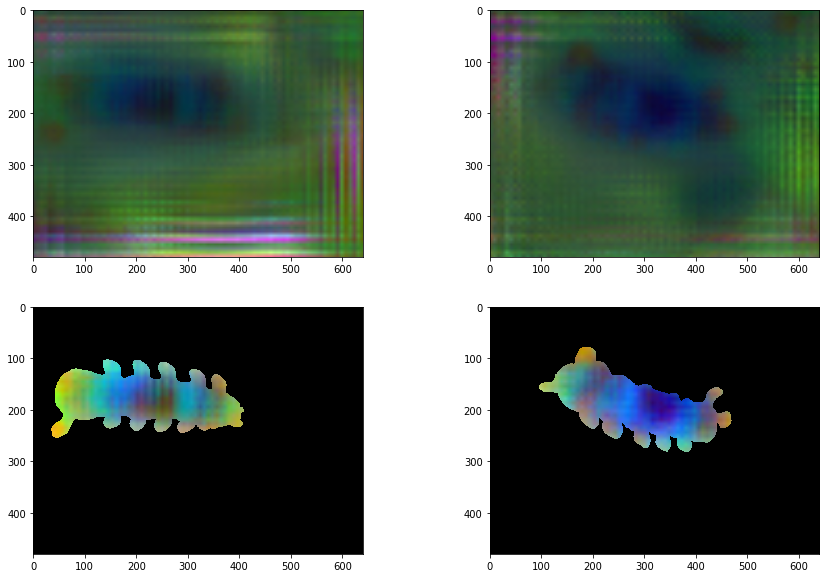



-----------Test Data Evaluation on dramamine----------------
Image pair (1898, 2365)
Could not find descriptor image stats...
Only normalizing pairs of images!


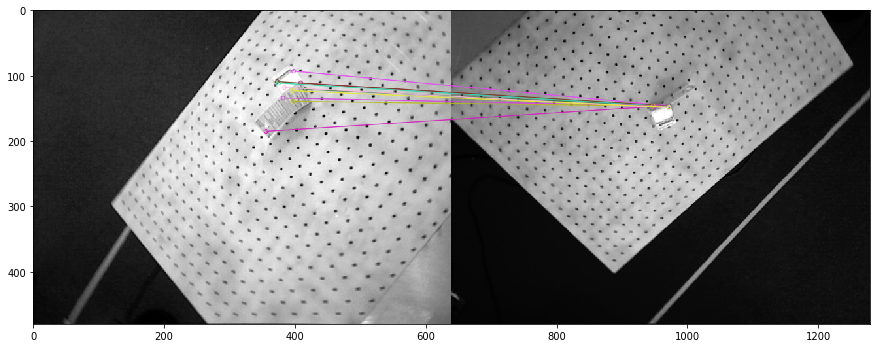

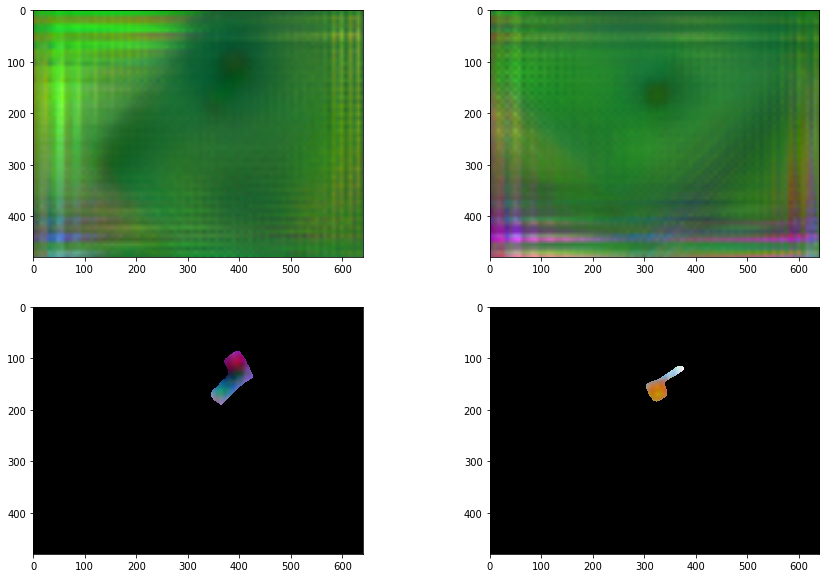



-----------Test Data Evaluation on drill----------------
Image pair (520, 1808)
Could not find descriptor image stats...
Only normalizing pairs of images!


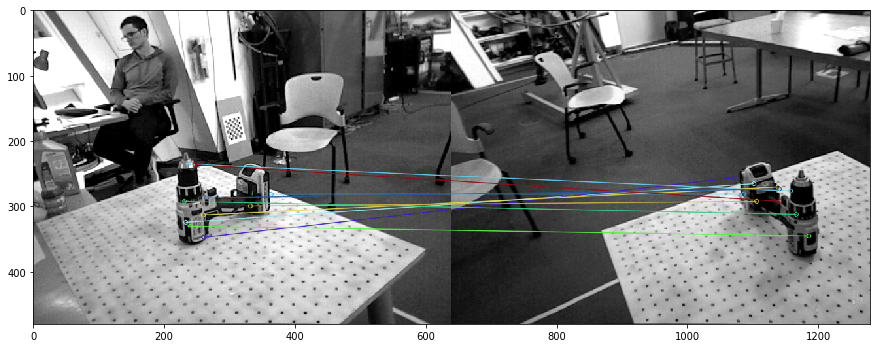

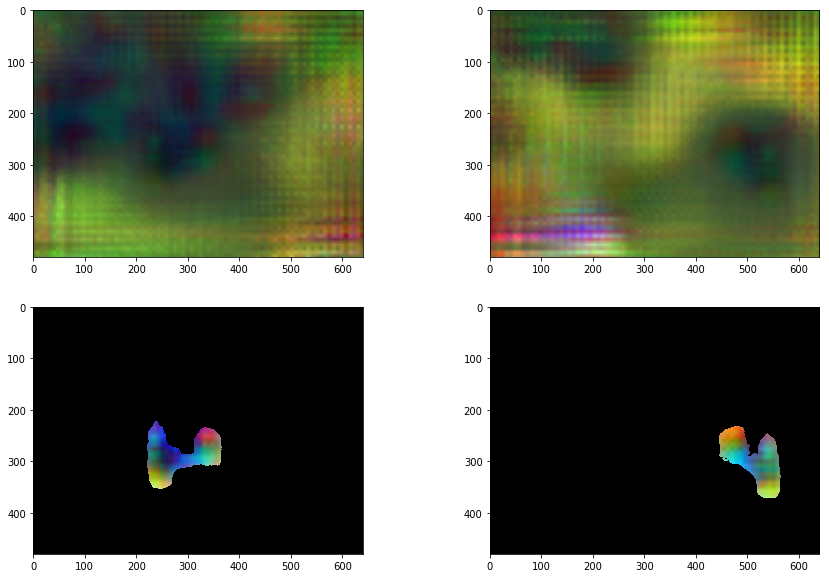



-----------Test Data Evaluation on gopro_box----------------
Image pair (1979, 1354)
Could not find descriptor image stats...
Only normalizing pairs of images!


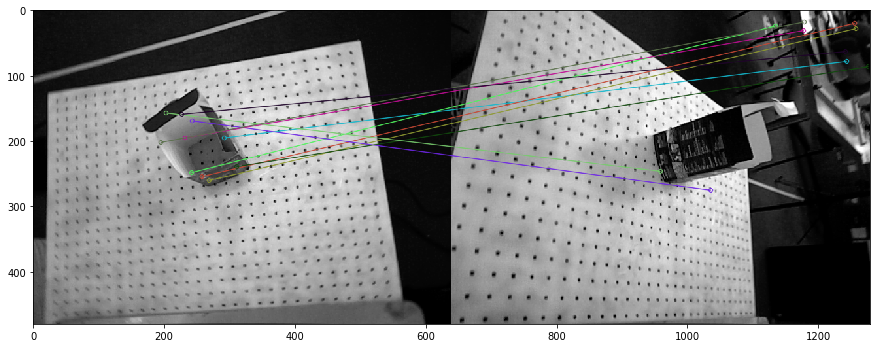

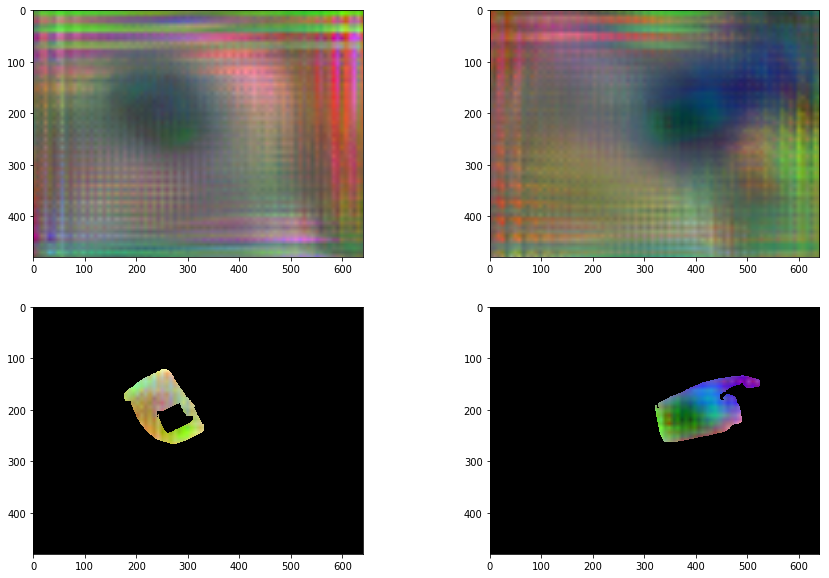



-----------Test Data Evaluation on headphones----------------
Image pair (1764, 381)
Could not find descriptor image stats...
Only normalizing pairs of images!


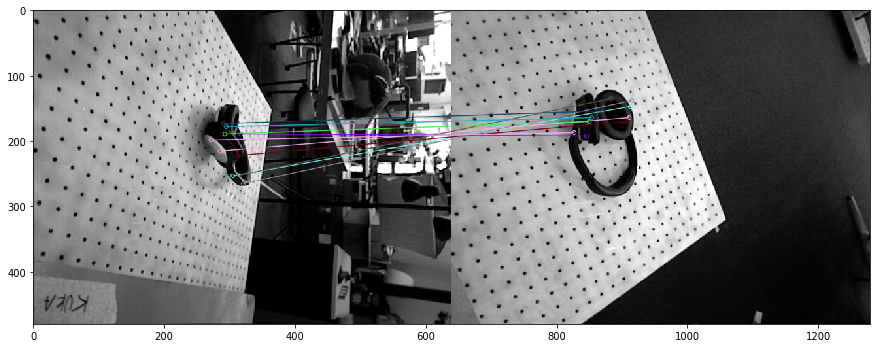

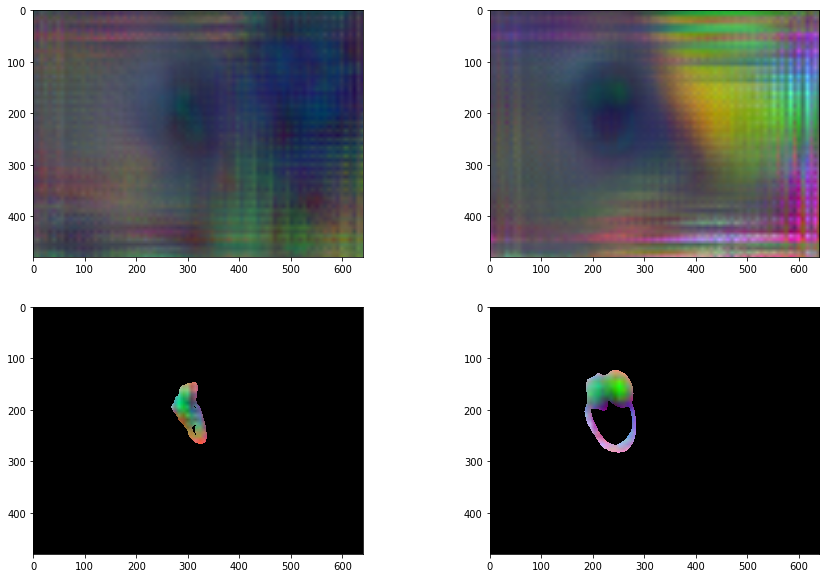

 57%|█████▋    | 2003/3500 [15:18<46:46,  1.88s/it]  


 empty data, continuing 



 58%|█████▊    | 2027/3500 [15:28<10:29,  2.34it/s]

warning, empty mask b


 58%|█████▊    | 2035/3500 [15:31<10:29,  2.33it/s]

warning, empty mask b


 60%|██████    | 2113/3500 [16:05<10:08,  2.28it/s]

warning, empty mask b


 70%|███████   | 2453/3500 [18:34<07:31,  2.32it/s]

warning, empty mask b


 70%|███████   | 2454/3500 [18:34<07:23,  2.36it/s]

warning, empty mask b


 70%|███████   | 2457/3500 [18:36<07:25,  2.34it/s]

warning, empty mask b


 71%|███████▏  | 2500/3500 [18:54<07:20,  2.27it/s]/home/ashek/code/modules/dense_correspondence_manipulation/utils/utils.py:266: RuntimeWarning: invalid value encountered in arccos
  theta = 2*np.arccos(2 * np.dot(q,r)**2 - 1)




-----------Test Data Evaluation on caterpillar----------------
Image pair (1374, 801)
Could not find descriptor image stats...
Only normalizing pairs of images!


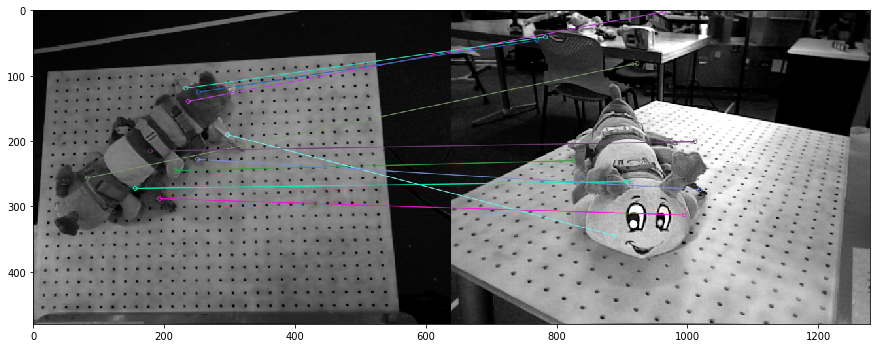

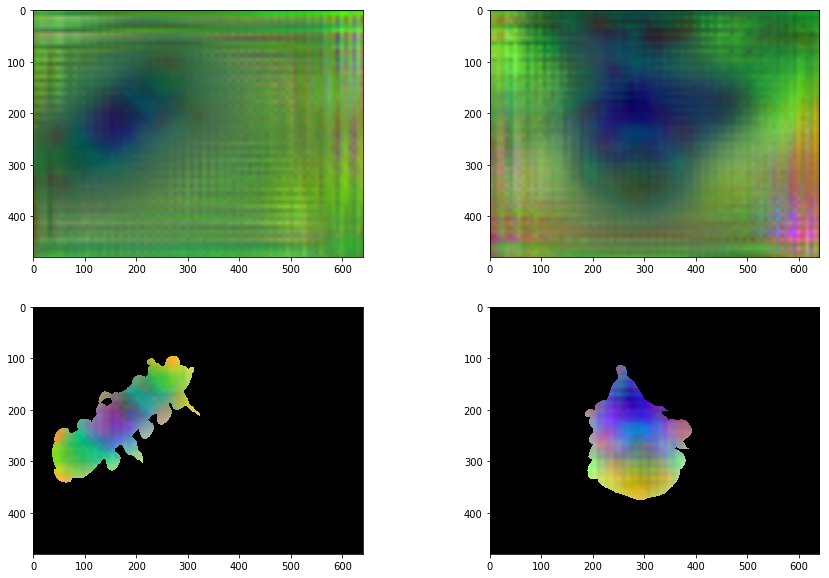



-----------Test Data Evaluation on dramamine----------------
Image pair (320, 2113)
Could not find descriptor image stats...
Only normalizing pairs of images!


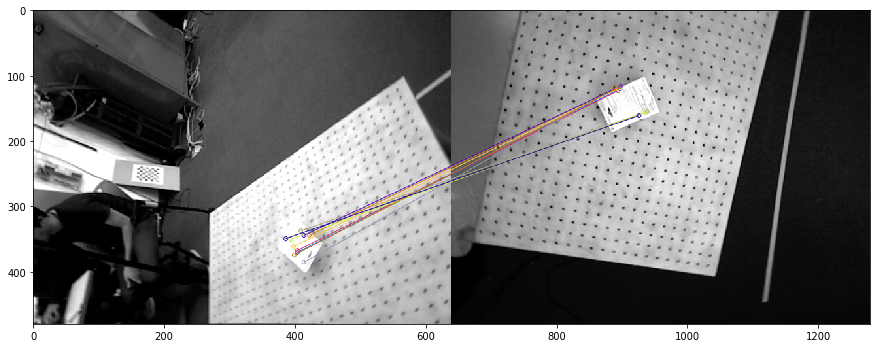

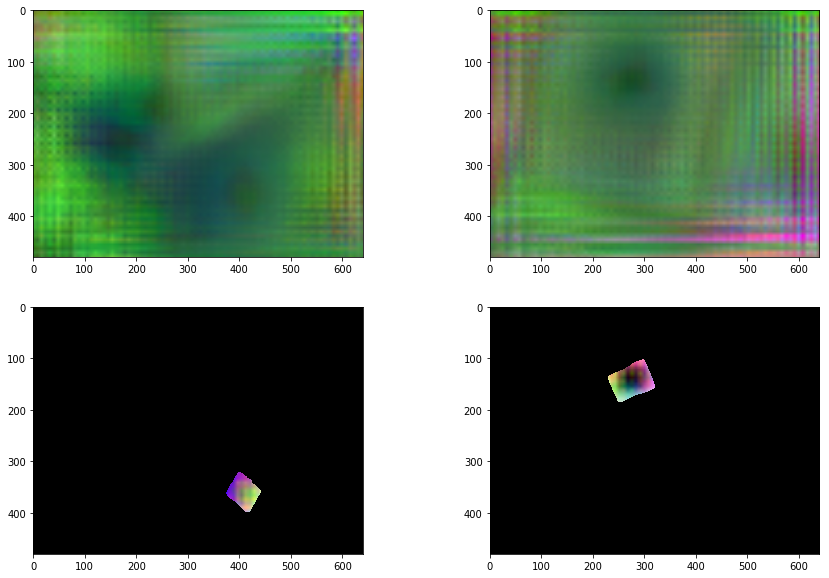



-----------Test Data Evaluation on drill----------------
Image pair (2151, 475)
Could not find descriptor image stats...
Only normalizing pairs of images!


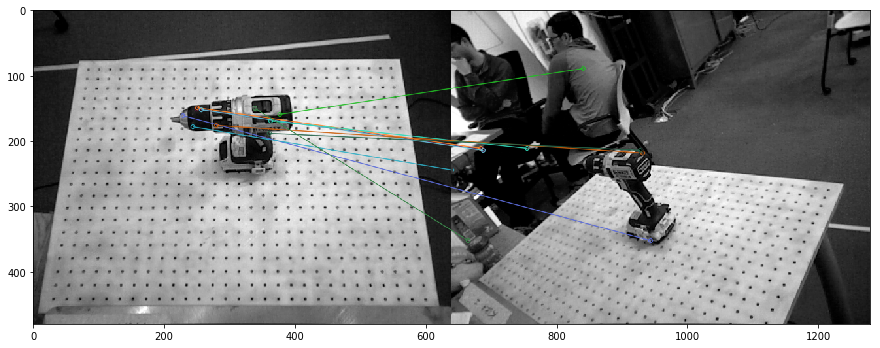

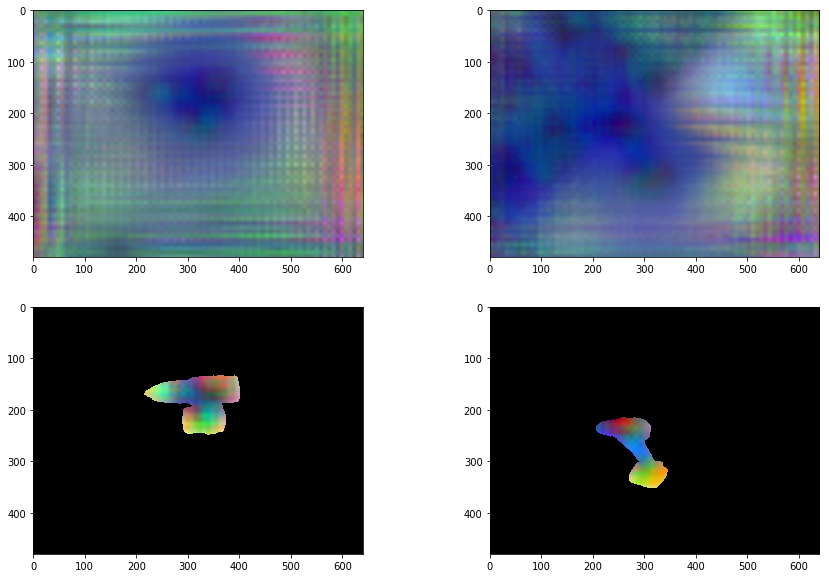



-----------Test Data Evaluation on gopro_box----------------
Image pair (1892, 77)
Could not find descriptor image stats...
Only normalizing pairs of images!


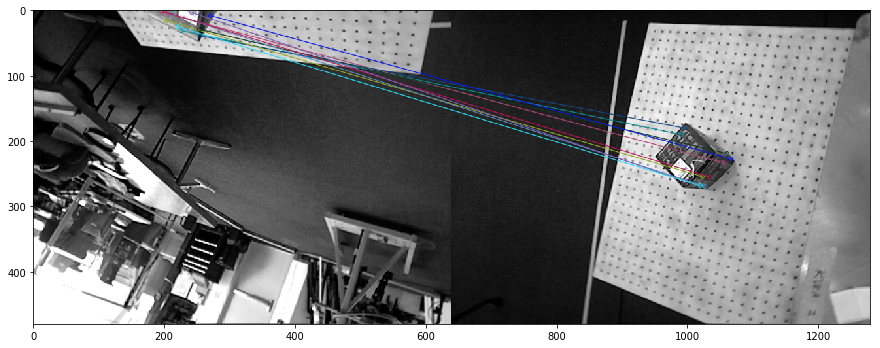

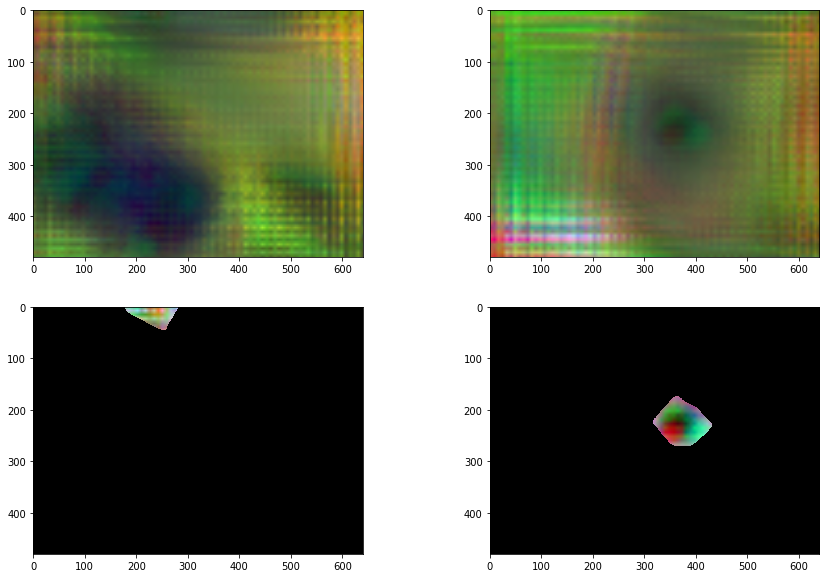



-----------Test Data Evaluation on headphones----------------
Image pair (2429, 823)
Could not find descriptor image stats...
Only normalizing pairs of images!


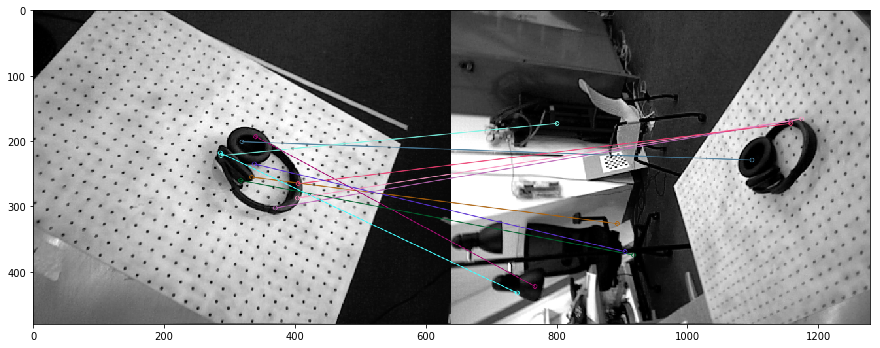

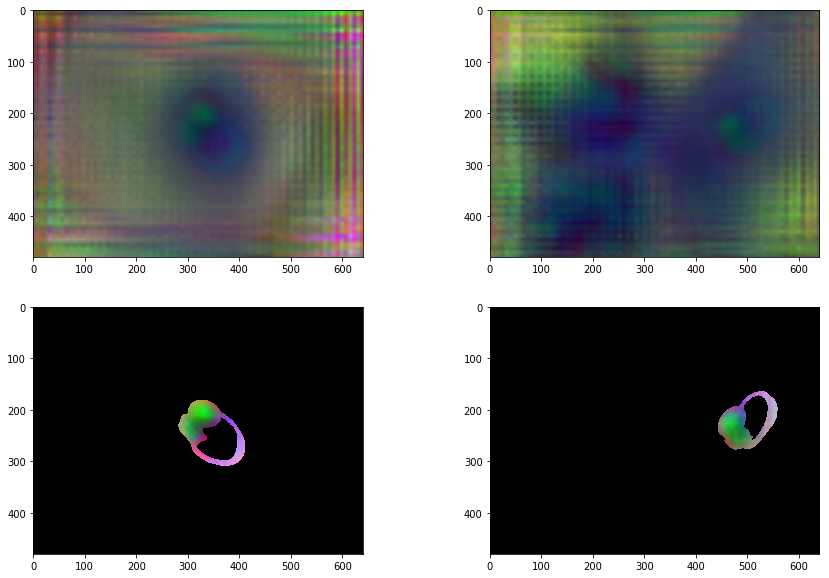

 75%|███████▍  | 2619/3500 [19:56<06:29,  2.26it/s]


 empty data, continuing 



 82%|████████▏ | 2857/3500 [21:40<04:40,  2.29it/s]


 empty data, continuing 



 82%|████████▏ | 2884/3500 [21:51<04:30,  2.28it/s]


 empty data, continuing 



 86%|████████▌ | 3000/3500 [22:41<03:38,  2.29it/s]



-----------Test Data Evaluation on caterpillar----------------
Image pair (592, 1402)
Could not find descriptor image stats...
Only normalizing pairs of images!


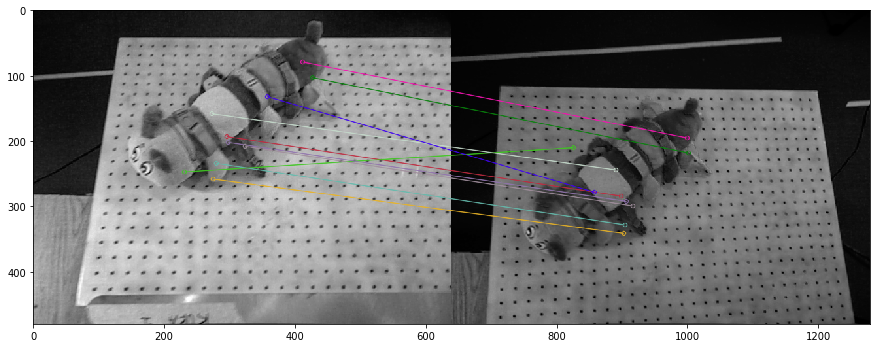

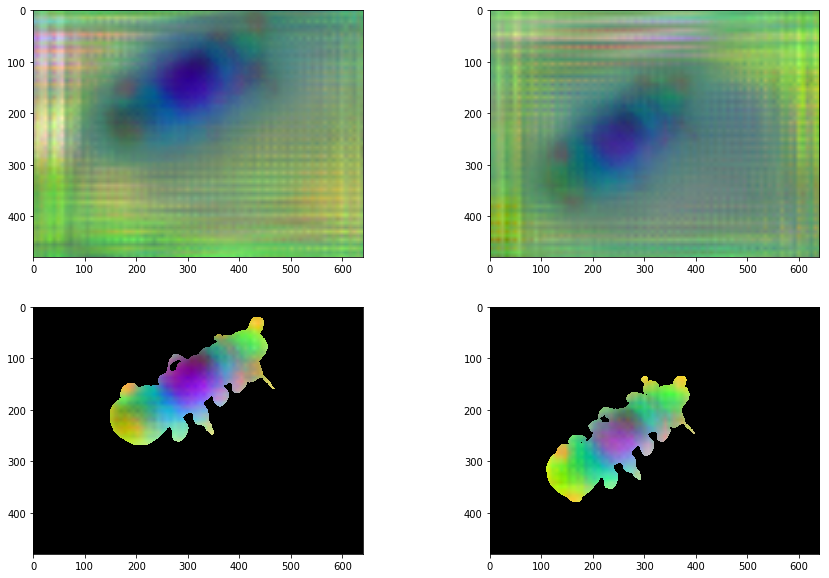



-----------Test Data Evaluation on dramamine----------------
Image pair (285, 1036)
Could not find descriptor image stats...
Only normalizing pairs of images!


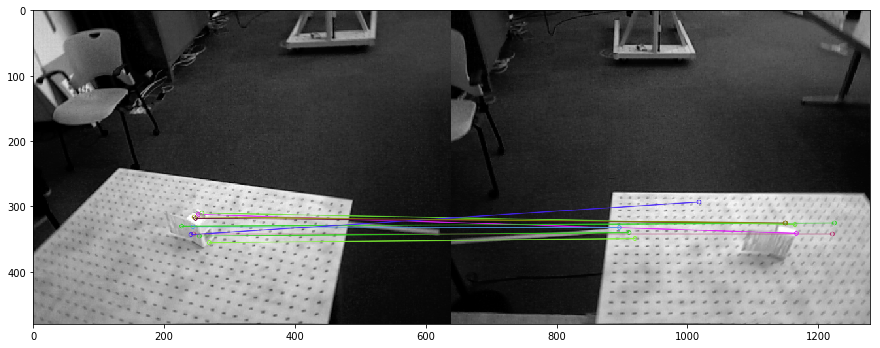

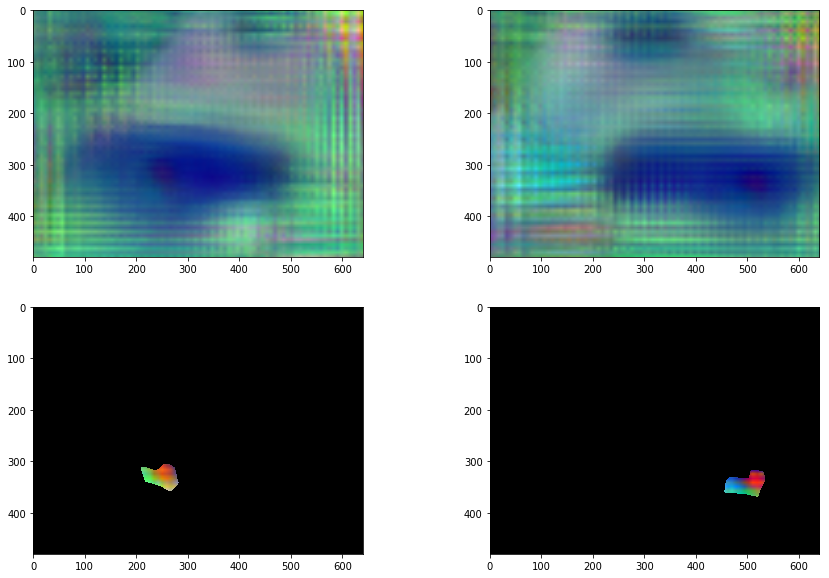



-----------Test Data Evaluation on drill----------------
Image pair (1600, 113)
Could not find descriptor image stats...
Only normalizing pairs of images!


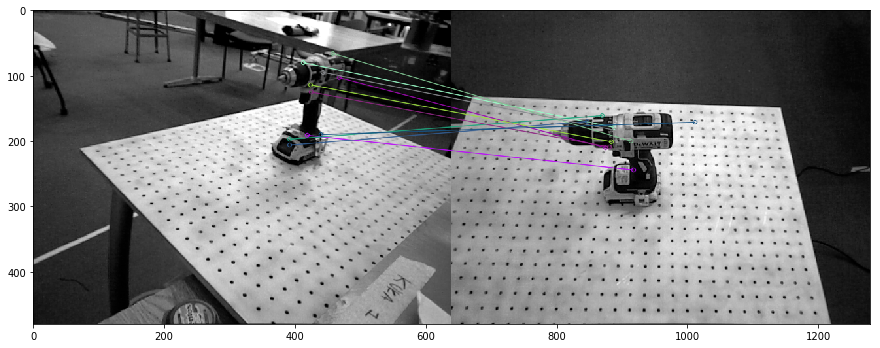

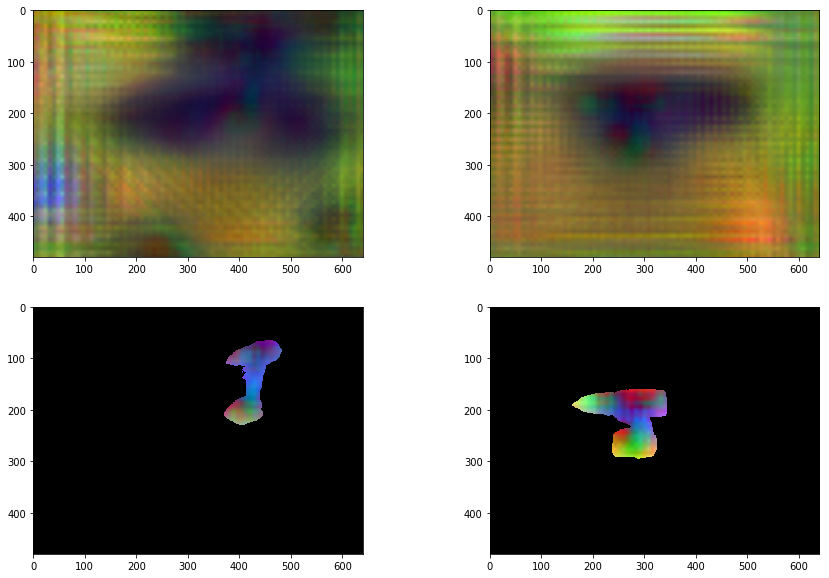



-----------Test Data Evaluation on gopro_box----------------
Image pair (668, 231)
Could not find descriptor image stats...
Only normalizing pairs of images!


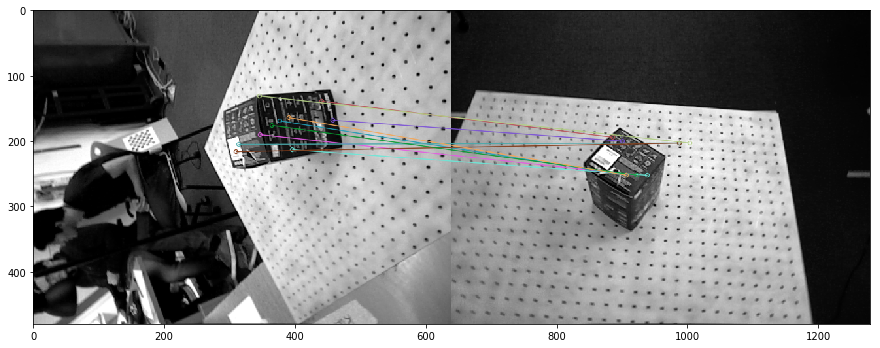

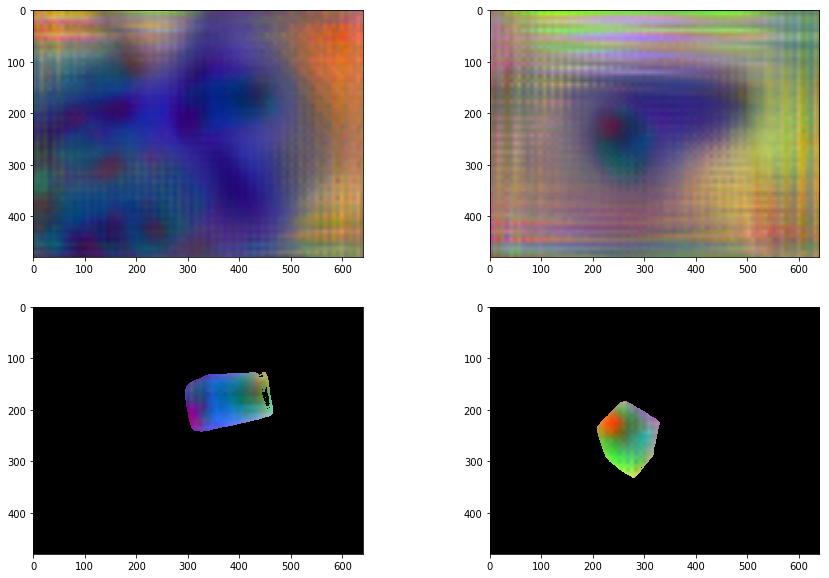



-----------Test Data Evaluation on headphones----------------
Image pair (85, 976)
Could not find descriptor image stats...
Only normalizing pairs of images!


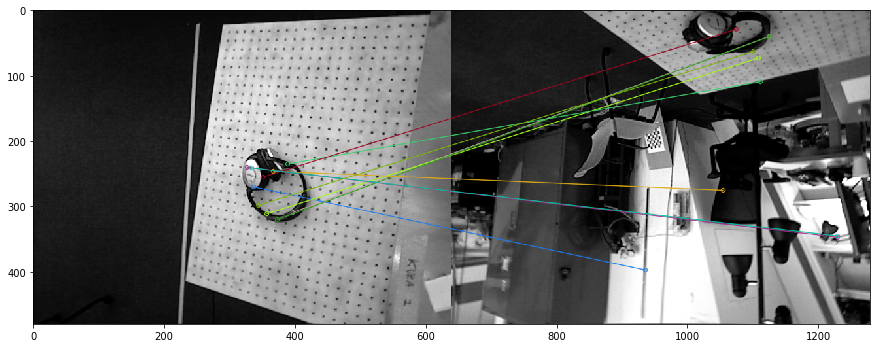

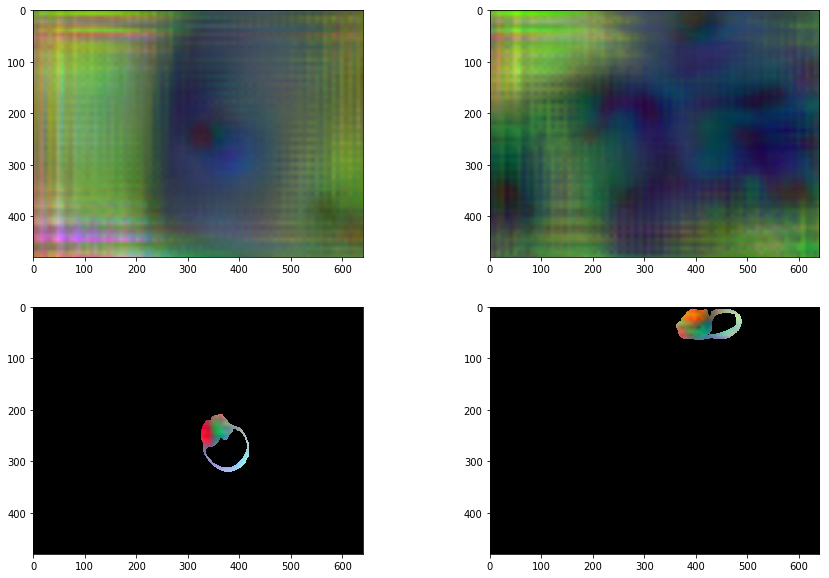

 89%|████████▊ | 3102/3500 [23:36<02:54,  2.28it/s]


 empty data, continuing 



 99%|█████████▉| 3465/3500 [26:15<00:15,  2.25it/s]


 empty data, continuing 



100%|██████████| 3500/3500 [26:30<00:00,  2.24it/s]



-----------Test Data Evaluation on caterpillar----------------
Image pair (1389, 917)
Could not find descriptor image stats...
Only normalizing pairs of images!


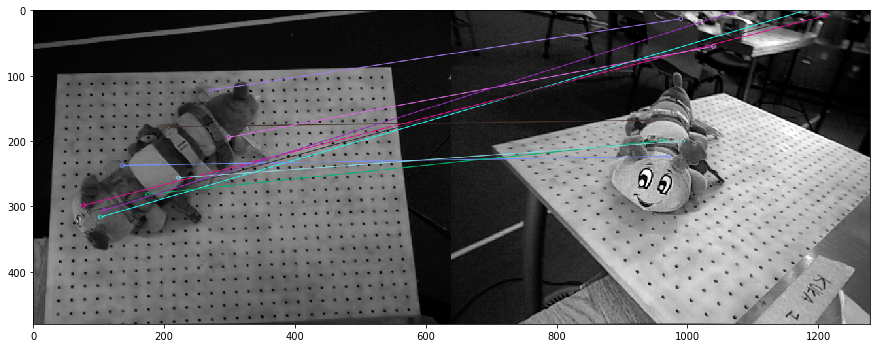

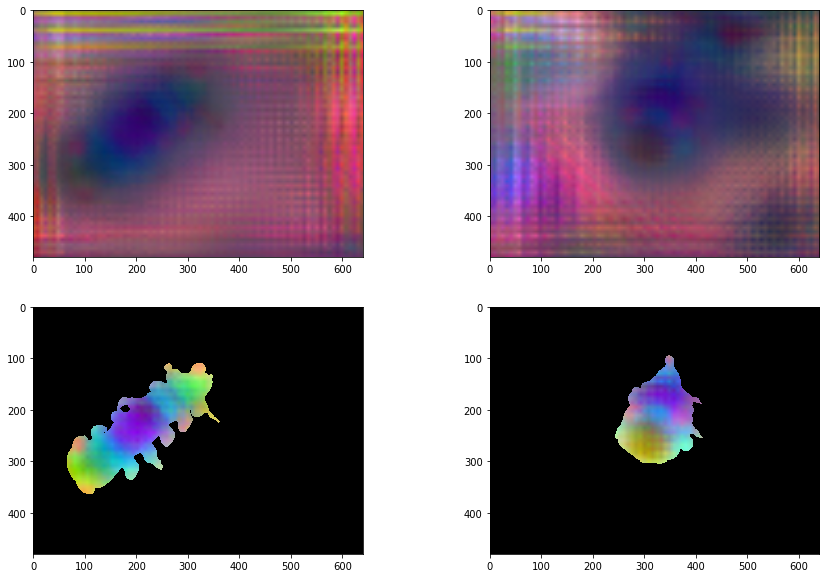



-----------Test Data Evaluation on dramamine----------------
Image pair (1702, 9)
Could not find descriptor image stats...
Only normalizing pairs of images!


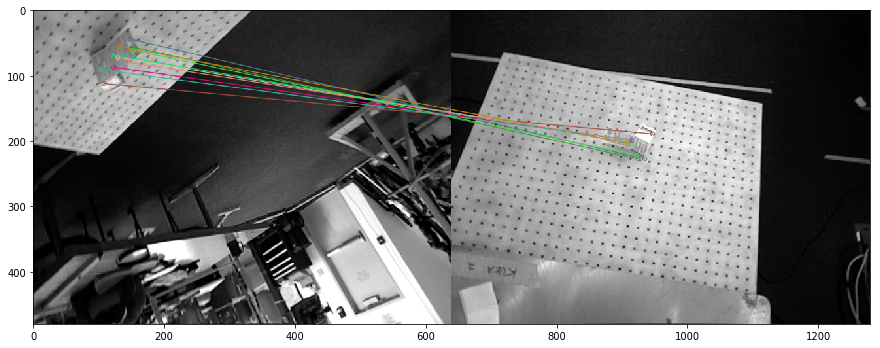

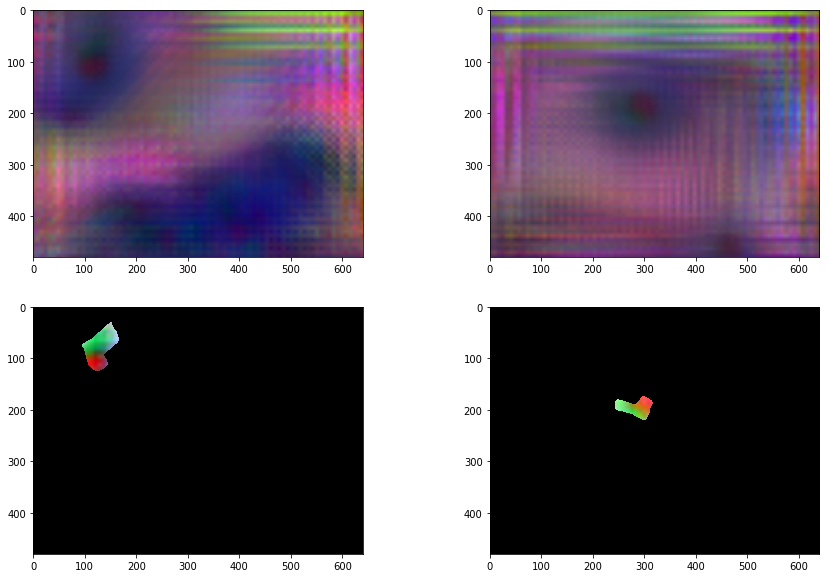



-----------Test Data Evaluation on drill----------------
Image pair (70, 629)
Could not find descriptor image stats...
Only normalizing pairs of images!


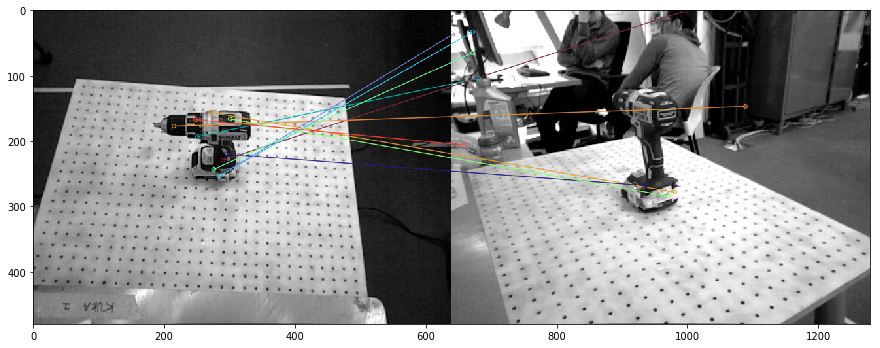

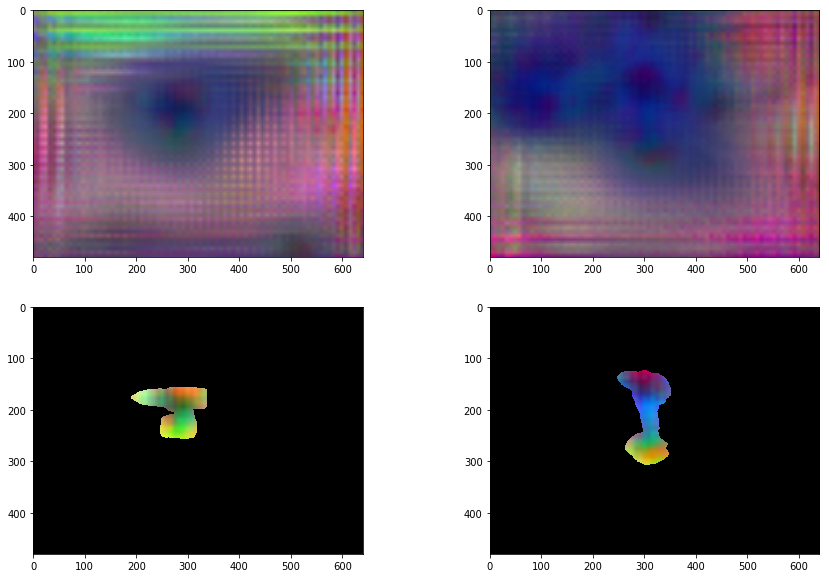



-----------Test Data Evaluation on gopro_box----------------
Image pair (2007, 668)
Could not find descriptor image stats...
Only normalizing pairs of images!


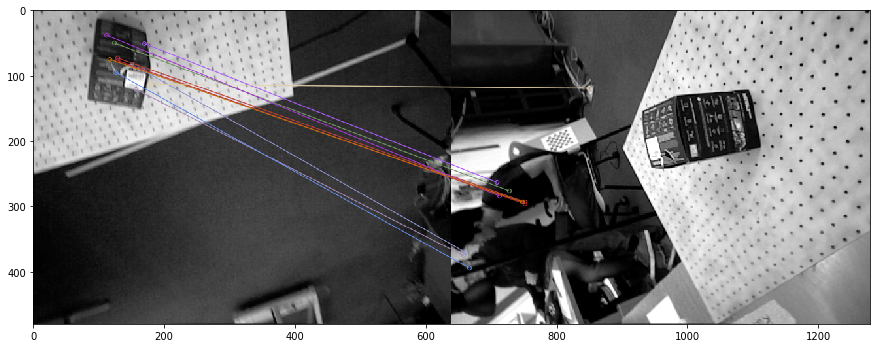

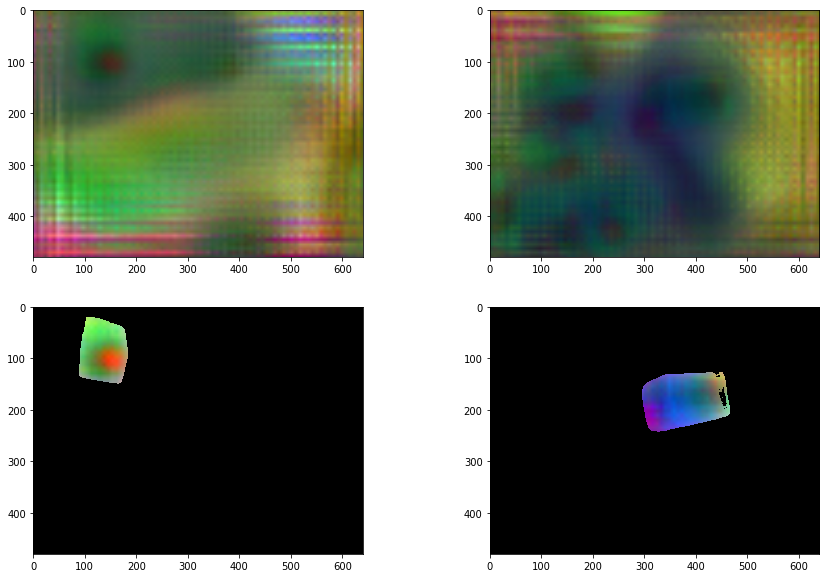



-----------Test Data Evaluation on headphones----------------
Image pair (863, 87)
Could not find descriptor image stats...
Only normalizing pairs of images!


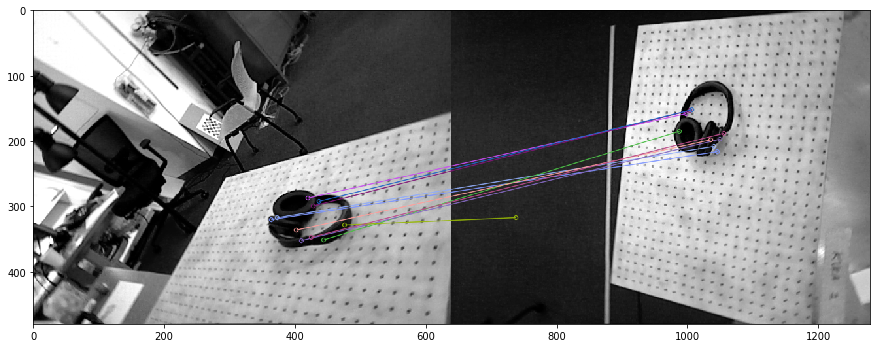

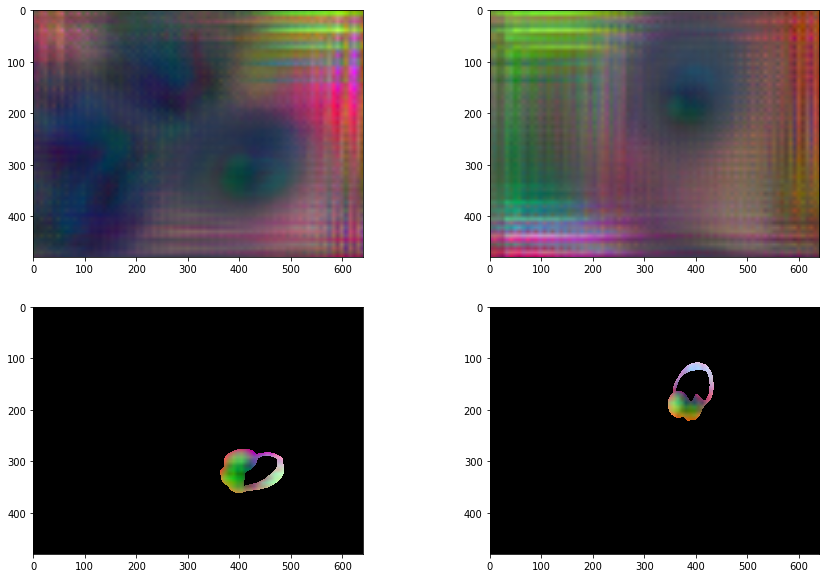

3501it [26:41,  2.19it/s]                          

finished training descriptor of dimension 3


In [4]:
# All of the saved data for this network will be located in the
# code/data/pdc/trained_models/tutorials/caterpillar_3 folder

print "training descriptor of dimension %d" %(d)
train = DenseCorrespondenceTraining(config=train_config)
train.load_dataset_from_config(config=data_config)
train.run()
print "finished training descriptor of dimension %d" %(d)

# Each batch, select a random image from a random scene
# for that image, find another image from the same scene
# but a taken from a diff view.
# then generate both pixel matches and non-matches 
# yes there is a heuristic approach, but it seeems complex
# and thus runtime is long. Prune non-matches based on:
# 1. depth is 0 (thus invalid, cannot use)
# 2. Project pixels from im1 to onto im2 and check if outside FOV
# 3. check if pixel is occluded using some method
# complicated... don't touch

# Fine-tune on New Objects

In [5]:
# New objects
# Datasets available:
# caterpillar_upright
# mugs
# shoes
# drills
config_filename = os.path.join(utils.getDenseCorrespondenceSourceDir(), 'config', 'dense_correspondence', 
                               'dataset', 'composite', 'finetune.yaml')
finetune_config = utils.getDictFromYamlFilename(config_filename)
finetune_config['logs_root_path'] = '/home/ashek/code/data/pdc/logs_proto'
finetune_dataset = SpartanDataset(config=finetune_config)
print(json.dumps(finetune_config, indent=2))

Using SpartanDataset:
   - in train mode
   - number of scenes 7
   - total images:     1383
DATASET MODE: train
{
  "logs_root_path": "/home/ashek/code/data/pdc/logs_proto", 
  "single_object_scenes_config_files": [
    "10_drill_scenes.yaml"
  ], 
  "multi_object_scenes_config_files": []
}


In [6]:
num_iterations = 1500
d = 3 # the descriptor dimension
train_config["training"]["num_iterations"] = num_iterations
print(json.dumps(train_config, indent=2))

{
  "device": "cuda", 
  "training": {
    "data_type_probabilities": {
      "SINGLE_OBJECT_ACROSS_SCENE": 0, 
      "SINGLE_OBJECT_WITHIN_SCENE": 1, 
      "DIFFERENT_OBJECT": 0, 
      "SYNTHETIC_MULTI_OBJECT": 0, 
      "MULTI_OBJECT": 0
    }, 
    "num_test_imgs_per_scene": 1, 
    "save_rate": 1000, 
    "num_workers": 5, 
    "logging_dir": "/home/ashek/code/data/pdc/trained_models/tutorials", 
    "compute_test_loss": true, 
    "sample_matches_only_off_mask": true, 
    "fraction_masked_non_matches": 0.5, 
    "batch_size": 1, 
    "domain_randomize": true, 
    "num_matching_attempts": 10000, 
    "weight_decay": 0.0001, 
    "learning_rate_decay": 0.9, 
    "compute_test_loss_rate": 500, 
    "num_non_matches_per_match": 150, 
    "num_iterations": 1500, 
    "steps_between_learning_rate_decay": 250, 
    "cross_scene_num_samples": 10000, 
    "logging_dir_name": "dcn_pretraining_2022_05_13_16:34:47", 
    "loss_function": "pixelwise_contrastive_loss", 
    "fraction_backgr

In [7]:
model_folder = os.path.join(logging_dir, name)
model_folder = utils.convert_data_relative_path_to_absolute_path(model_folder)
print("Loading %s" % model_folder)
iteration = 3501
print "training descriptor of dimension %d" %(d)
finetune = DenseCorrespondenceTraining(dataset=finetune_dataset, config=train_config)
finetune.run_from_pretrained(model_folder, iteration)
print "finished training descriptor of dimension %d" %(d)

Loading /home/ashek/code/data/pdc/trained_models/tutorials/dcn_pretraining_2022_05_13_16:34:47
training descriptor of dimension 3
model_param_file 003501.pth
cuda
using SINGLE_OBJECT_WITHIN_SCENE


KeyError: 'single_object_scenes_config_files'

## Evaluate the network quantitatively

This should take ~5 minutes.

In [ ]:
# Evaluate initial model (no fine-tuning) on original train dataset
DCE = DenseCorrespondenceEvaluation
iteration = 3501
num_image_pairs = 100
save_folder_name = "analysis"
DCE.run_evaluation_on_network(model_folder, iteration=iteration, num_image_pairs=num_image_pairs,
                             dataset=dataset, save_folder_name=save_folder_name)      

In [ ]:
# Evaluate fine-tuned model on original train dataset
iteration = 5002
num_image_pairs = 100
save_folder_name = "finetune_analysis_orig_data"
DCE.run_evaluation_on_network(model_folder, iteration=iteration, num_image_pairs=num_image_pairs,
                             dataset=dataset, save_folder_name=save_folder_name)         

In [ ]:
# Evaluate fine-tuned model on new finetuned dataset
DCE = DenseCorrespondenceEvaluation
iteration = 5002
num_image_pairs = 100
save_folder_name = "finetune_analysis_finetune_data"
DCE.run_evaluation_on_network(model_folder, iteration=iteration, num_image_pairs=num_image_pairs,
                             dataset=finetune_dataset, save_folder_name=save_folder_name)      

See `evaluation_quantitative_tutorial.ipynb` for a better place to display the plots.

In [ ]:
# Finetune on 2nd additional dataset just to emphasize issue further
config_filename = os.path.join(utils.getDenseCorrespondenceSourceDir(), 'config', 'dense_correspondence', 
                               'dataset', 'composite', 'finetune2.yaml')
finetune2_config = utils.getDictFromYamlFilename(config_filename)
finetune2_config['logs_root_path'] = '/home/ashek/code/data/pdc/logs_proto'
finetune2_dataset = SpartanDataset(config=finetune_config)
print(json.dumps(finetune2_config, indent=2))

In [ ]:
model_folder = os.path.join(logging_dir, name)
model_folder = utils.convert_data_relative_path_to_absolute_path(model_folder)
print("Loading %s" % model_folder)
iteration = 5002
print "training descriptor of dimension %d" %(d)
finetune2 = DenseCorrespondenceTraining(dataset=finetune2_dataset, config=train_config)
finetune2.run_from_pretrained(model_folder, iteration)
print "finished training descriptor of dimension %d" %(d)

In [ ]:
# Evaluate fine-tuned2 model on new finetuned2 dataset
DCE = DenseCorrespondenceEvaluation
iteration = 6503
num_image_pairs = 100
save_folder_name = "finetune2_analysis_finetune_data2"
DCE.run_evaluation_on_network(model_folder, iteration=iteration, num_image_pairs=num_image_pairs,
                             dataset=finetune2_dataset, save_folder_name=save_folder_name)      

In [ ]:
# Evaluate fine-tuned model on original train dataset
iteration = 6503
num_image_pairs = 100
save_folder_name = "finetune2_analysis_orig_data"
DCE.run_evaluation_on_network(model_folder, iteration=iteration, num_image_pairs=num_image_pairs,
                             dataset=dataset, save_folder_name=save_folder_name)         